In [1]:
import matplotlib
import matplotlib.pyplot as plt # plotting
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import scipy
import scipy.interpolate
import scipy
import statistics
from pywt import wavedec
from scipy import signal
import matplotlib.colors as mcolors
import random
import seaborn as sns
import os
from scipy import stats
import statsmodels.api as sm
from numpy import asarray
from numpy import savetxt
import pickle
import csv

#Import funcions
from BandPowerr import plotbar_info_rac
from BandPowerr import plotbar_info_bandpower1
from BandPowerr import calcul

In [2]:
#Obrim els seguents archius:

#Data EO amb 12 brain reagions y els powerband
with open("/Users/laianavarroolivella/Proyectos/EEG/3.1 ExtractDataOutliers/Dades_no_outliersEO.txt", "rb") as fp: 
    dataEO = pickle.load(fp)

#Data EC amb 12 brain reagions y els powerband
with open("/Users/laianavarroolivella/Proyectos/EEG/3.1 ExtractDataOutliers/Dades_no_outliersEC.txt", "rb") as fp: 
    dataEC = pickle.load(fp)

#Llista dels noms dels pacients EC 
with open("/Users/laianavarroolivella/Proyectos/EEG/3.1 ExtractDataOutliers/Listoflist_no_outliersEC.txt", "rb") as fp:   # Unpickling
    listEC_Names = pickle.load(fp)

#Llista dels noms dels pacients EO 
with open("/Users/laianavarroolivella/Proyectos/EEG/3.1 ExtractDataOutliers/Listoflist_no_outliersEO.txt", "rb") as fp:   # Unpickling
    listEO_Names = pickle.load(fp)

In [3]:
#Import the data to analise
#Open the file in universal line ending mode 
with open('/Users/laianavarroolivella/Proyectos/EEG/Files_EEG/TEIQue-SF.csv', 'rU') as infile:
  # read the file as a dictionary for each row ({header : value})
  data = {}
  reader = csv.DictReader(infile)
  for row in reader:
    for header, value in row.items():
      try:
        data[header].append(value)
      except KeyError:
        data[header] = [value]

# extract the variables you want
names = data['ID']
TeiQueSF_emotionality = data['TeiQueSF_emotionality']
TeiQueSF_wellBeing = data['TeiQueSF_well_being']

<ipython-input-3-7cd9a6c37a48>:3: DeprecationWarning: 'U' mode is deprecated
  with open('/Users/laianavarroolivella/Proyectos/EEG/Files_EEG/TEIQue-SF.csv', 'rU') as infile:


In [4]:
thEmotionality = 4.0
thWellBeing = 4.0

In [5]:
lis_noms = ['Anterior_midline', 'Left_frontal', 'Right_frontal', 'Left_temporal', 'Left_central', 'Left_parietal', 'Left_Occipital', 'Right_Occipital', 'Right_parietal', 'Right_temporal', 'Posterior_midline', 'Right_central']

labels = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gama Lower']

EO - Emotionality and well being - Average relative Band Power 

EO, Emotionality, Brain Reagion:  Anterior_midline


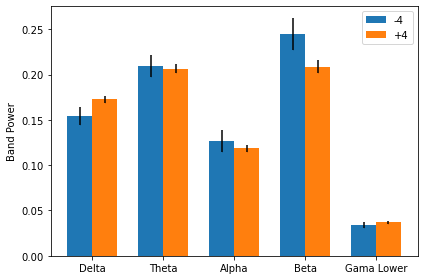

EO, Emotionality, Brain Reagion:  Left_frontal


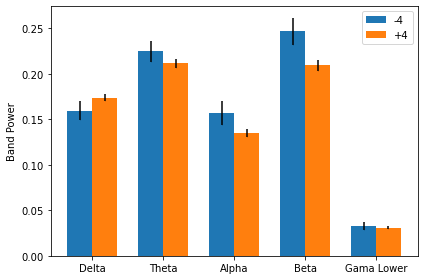

EO, Emotionality, Brain Reagion:  Right_frontal


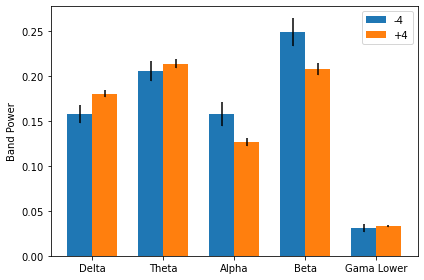

EO, Emotionality, Brain Reagion:  Left_temporal


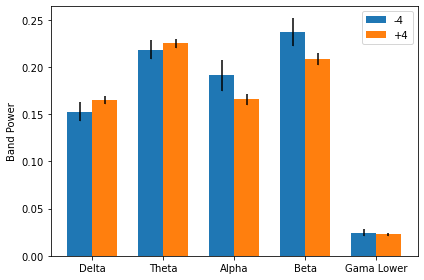

EO, Emotionality, Brain Reagion:  Left_central


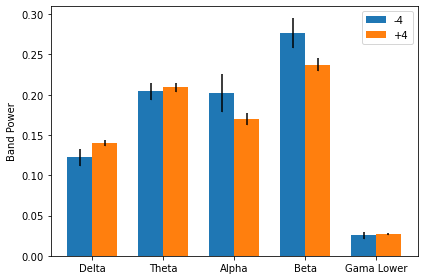

EO, Emotionality, Brain Reagion:  Left_parietal


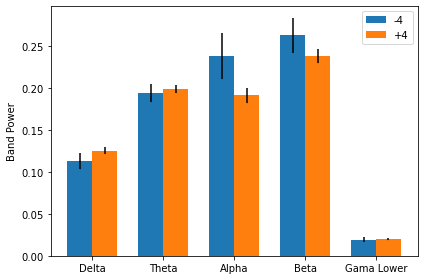

EO, Emotionality, Brain Reagion:  Left_Occipital


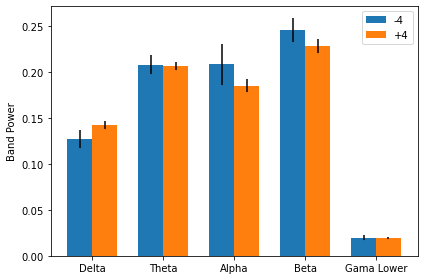

EO, Emotionality, Brain Reagion:  Right_Occipital


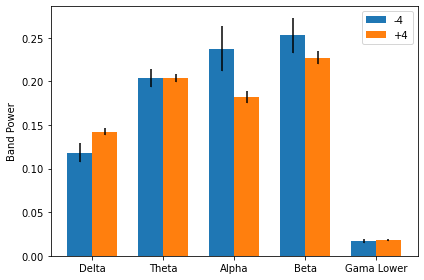

EO, Emotionality, Brain Reagion:  Right_parietal


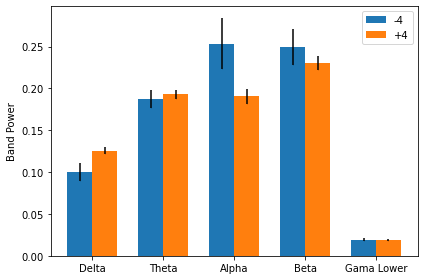

EO, Emotionality, Brain Reagion:  Right_temporal


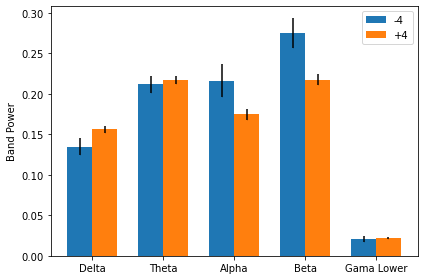

EO, Emotionality, Brain Reagion:  Posterior_midline


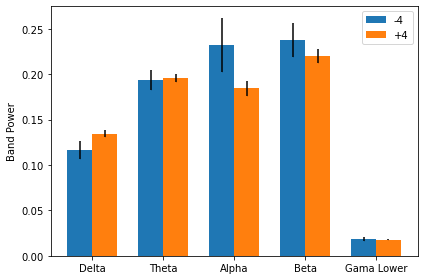

EO, Emotionality, Brain Reagion:  Right_central


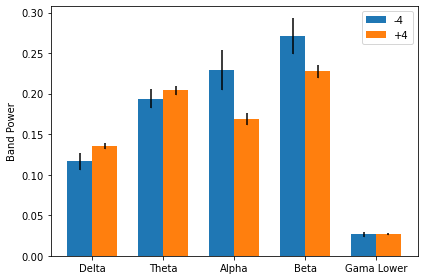

EO, Well Being, Brain Reagion:  Anterior_midline


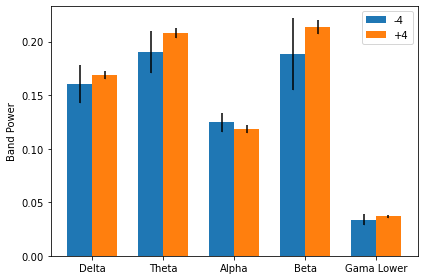

EO, Well Being, Brain Reagion:  Left_frontal


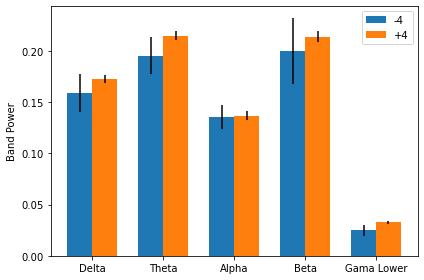

EO, Well Being, Brain Reagion:  Right_frontal


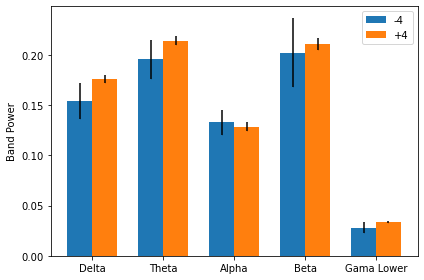

EO, Well Being, Brain Reagion:  Left_temporal


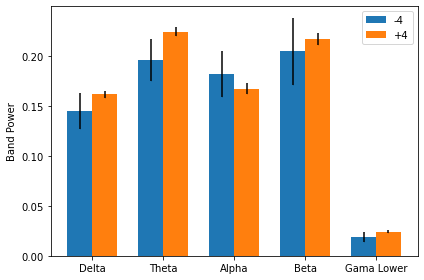

EO, Well Being, Brain Reagion:  Left_central


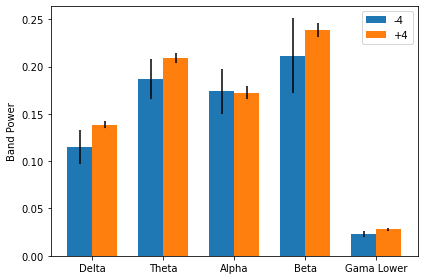

EO, Well Being, Brain Reagion:  Left_parietal


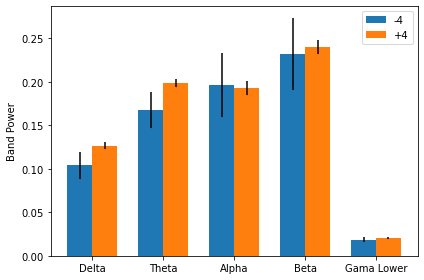

EO, Well Being, Brain Reagion:  Left_Occipital


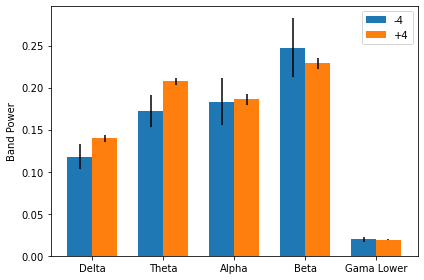

EO, Well Being, Brain Reagion:  Right_Occipital


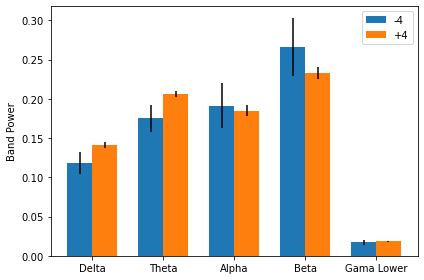

EO, Well Being, Brain Reagion:  Right_parietal


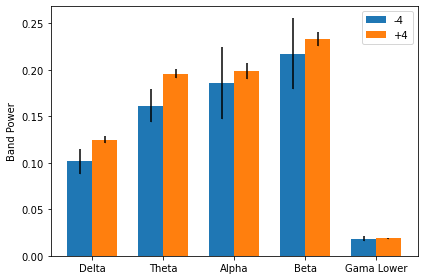

EO, Well Being, Brain Reagion:  Right_temporal


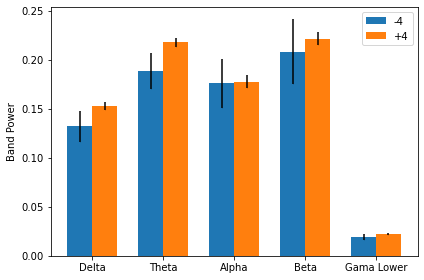

EO, Well Being, Brain Reagion:  Posterior_midline


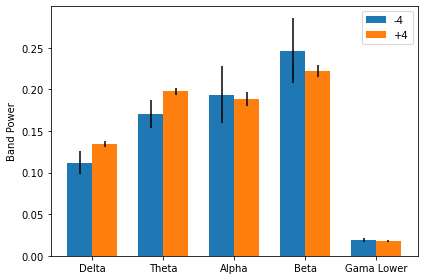

EO, Well Being, Brain Reagion:  Right_central


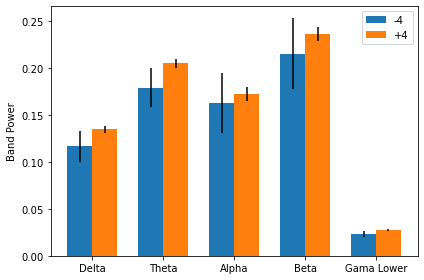

In [6]:
bandPower_emotio_EO = []
bandPower_well_EO = []

for r in range(0,12):
    print('EO, Emotionality, Brain Reagion: ',lis_noms[r])
    #check the str 
    #also see if the str is with the mean!
    band_emotio = plotbar_info_bandpower1(names, listEO_Names[r], TeiQueSF_emotionality, dataEO[r], thEmotionality)
    bandPower_emotio_EO.append(band_emotio)

for r in range(0,12):
    print('EO, Well Being, Brain Reagion: ',lis_noms[r])
    band_well = plotbar_info_bandpower1(names, listEO_Names[r], TeiQueSF_wellBeing, dataEO[r], thWellBeing)
    bandPower_well_EO.append(band_well)

EC - Emotionality and well being - Average relative Band Power

EC, Emotionality, Brain Reagion:  Anterior_midline


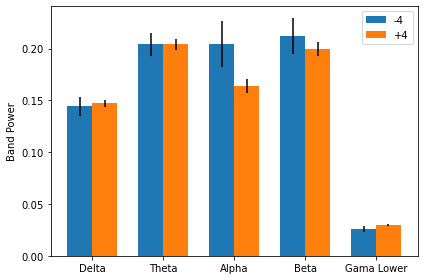

EC, Emotionality, Brain Reagion:  Left_frontal


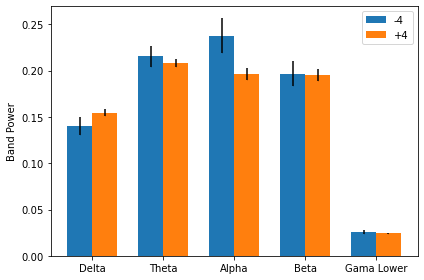

EC, Emotionality, Brain Reagion:  Right_frontal


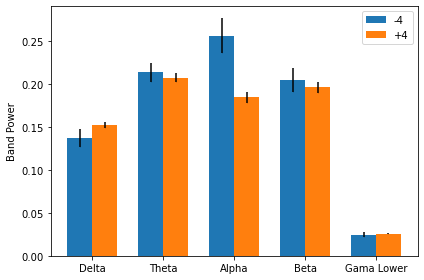

EC, Emotionality, Brain Reagion:  Left_temporal


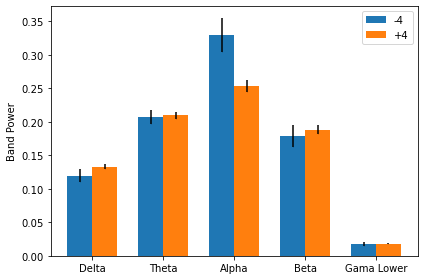

EC, Emotionality, Brain Reagion:  Left_central


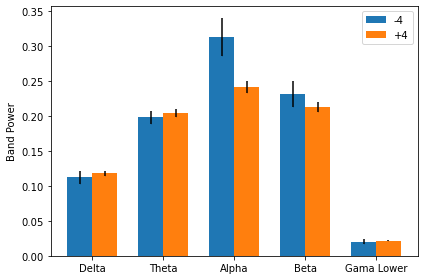

EC, Emotionality, Brain Reagion:  Left_parietal


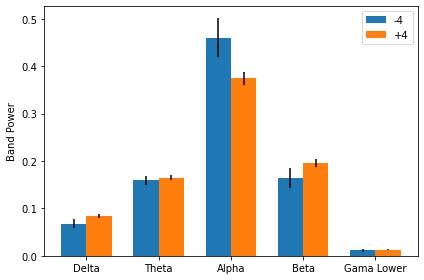

EC, Emotionality, Brain Reagion:  Left_Occipital


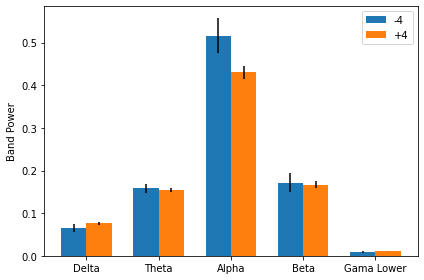

EC, Emotionality, Brain Reagion:  Right_Occipital


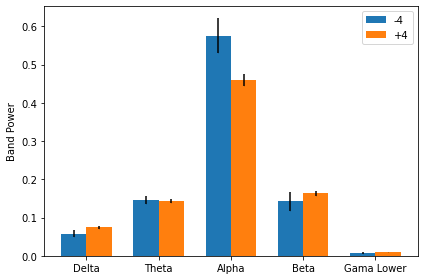

EC, Emotionality, Brain Reagion:  Right_parietal


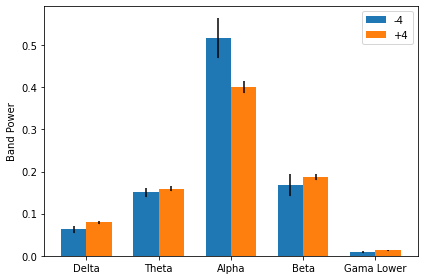

EC, Emotionality, Brain Reagion:  Right_temporal


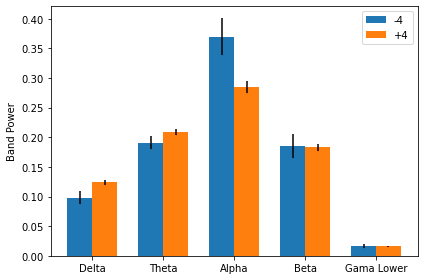

EC, Emotionality, Brain Reagion:  Posterior_midline


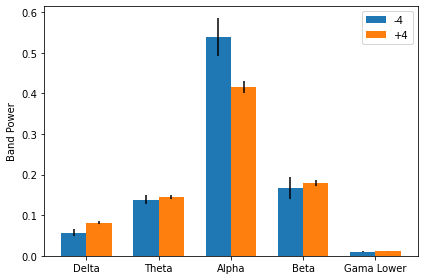

EC, Emotionality, Brain Reagion:  Right_central


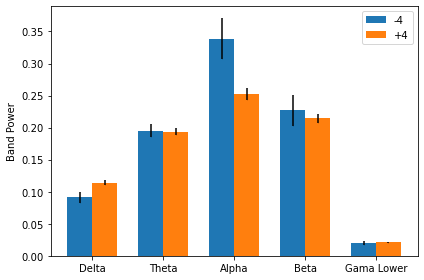

EC, Well Being, Brain Reagion:  Anterior_midline


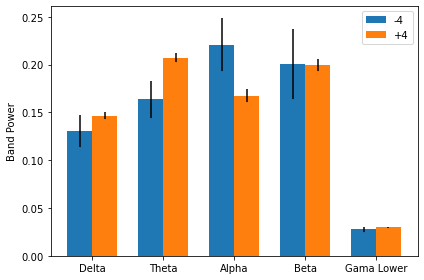

EC, Well Being, Brain Reagion:  Left_frontal


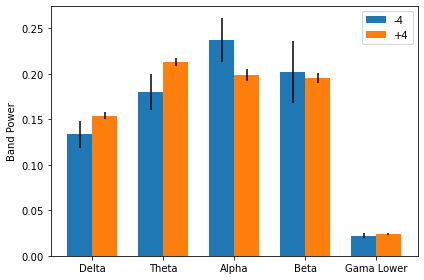

EC, Well Being, Brain Reagion:  Right_frontal


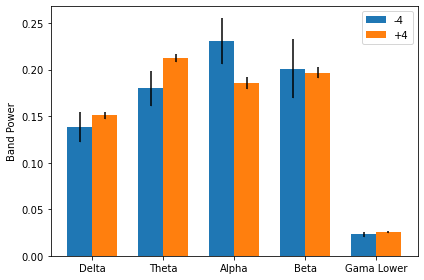

EC, Well Being, Brain Reagion:  Left_temporal


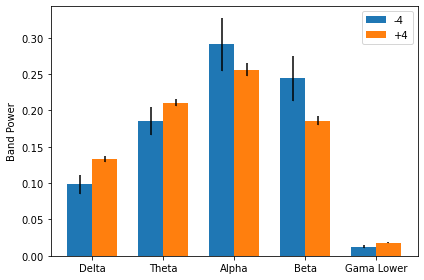

EC, Well Being, Brain Reagion:  Left_central


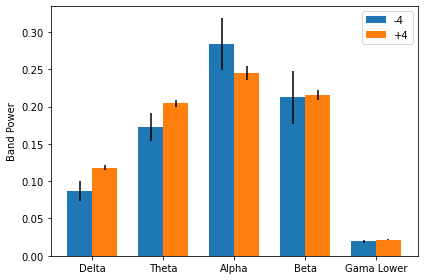

EC, Well Being, Brain Reagion:  Left_parietal


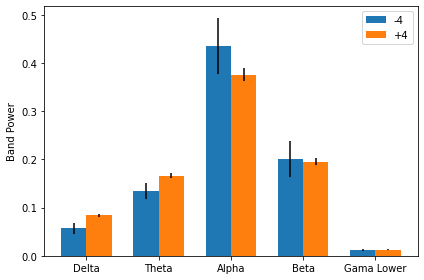

EC, Well Being, Brain Reagion:  Left_Occipital


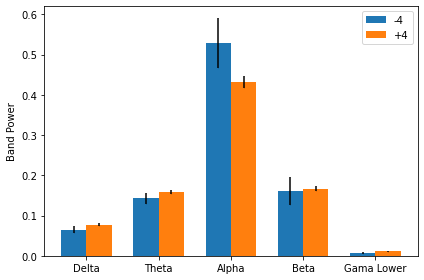

EC, Well Being, Brain Reagion:  Right_Occipital


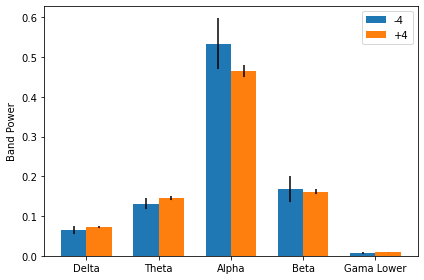

EC, Well Being, Brain Reagion:  Right_parietal


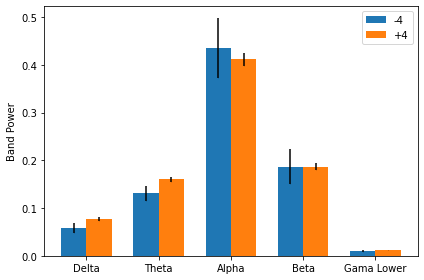

EC, Well Being, Brain Reagion:  Right_temporal


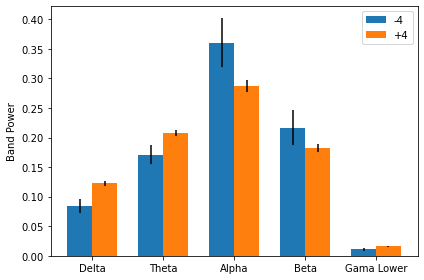

EC, Well Being, Brain Reagion:  Posterior_midline


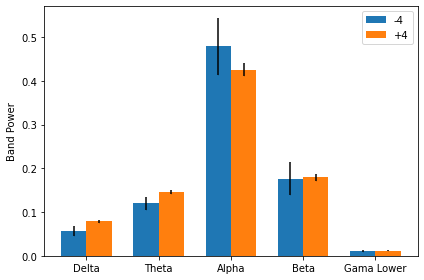

EC, Well Being, Brain Reagion:  Right_central


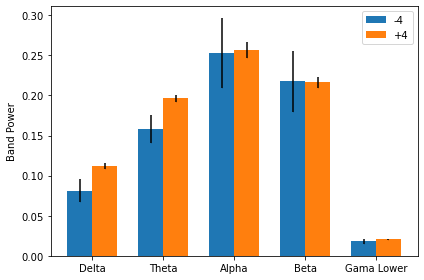

In [7]:
bandPower_emotio_EC = []
bandPower_well_EC = []

for r in range(0,12):
    print('EC, Emotionality, Brain Reagion: ',lis_noms[r])
    band_emotio = plotbar_info_bandpower1(names, listEC_Names[r], TeiQueSF_emotionality, dataEC[r], thEmotionality)
    bandPower_emotio_EC.append(band_emotio)

for r in range(0,12):
    print('EC, Well Being, Brain Reagion: ',lis_noms[r])
    band_well = plotbar_info_bandpower1(names, listEC_Names[r], TeiQueSF_wellBeing, dataEC[r], thWellBeing)
    bandPower_well_EC.append(band_well)

EC - Emotionality and well being - Rac

In [8]:
rac_emotio_EO = []
rac_well_EO = []

for r in range(0,12):
    print('EC, Emotionality, Brain Reagion: ',lis_noms[r])
    rac_emotio = plotbar_info_rac(names, listEO_Names[r], TeiQueSF_emotionality, dataEO[r], thEmotionality)
    rac_emotio_EO.append(rac_emotio)

for r in range(0,12):
    print('EO, Well Being, Brain Reagion: ',lis_noms[r])
    rac_well = plotbar_info_rac(names, listEO_Names[r], TeiQueSF_wellBeing, dataEO[r], thWellBeing)
    rac_well_EO.append(rac_well)

EC, Emotionality, Brain Reagion:  Anterior_midline
RanksumsResult(statistic=-0.5000467732605678, pvalue=0.6170421433505648)
RanksumsResult(statistic=-0.6929914531581163, pvalue=0.4883149151786641)
RanksumsResult(statistic=-0.7693077563883719, pvalue=0.4417106337597084)
RanksumsResult(statistic=1.0789025035863518, pvalue=0.2806311926671834)
RanksumsResult(statistic=-0.9020490454288764, pvalue=0.36703081477164035)
EC, Emotionality, Brain Reagion:  Left_frontal
RanksumsResult(statistic=-0.28263513271249485, pvalue=0.7774565459103906)
RanksumsResult(statistic=-0.2560420233811011, pvalue=0.7979183885810038)
RanksumsResult(statistic=-0.7096323767890929, pvalue=0.4779321366439975)
RanksumsResult(statistic=0.8623741521594463, pvalue=0.38848165956150094)
RanksumsResult(statistic=0.46755499921766286, pvalue=0.6401028522935919)
EC, Emotionality, Brain Reagion:  Right_frontal
RanksumsResult(statistic=-0.5163526463016733, pvalue=0.6056081326369049)
RanksumsResult(statistic=-0.6049925384713714, pval

In [9]:
rac_emotio_EC = []
rac_well_EC = []

lis_noms = ['Anterior_midline', 'Left_frontal', 'Right_frontal', 'Left_temporal', 'Left_central', 'Left_parietal', 'Left_Occipital', 'Right_Occipital', 'Right_parietal', 'Right_temporal', 'Posterior_midline', 'Right_central']

for r in range(0,12):
    print('EC, Emotionality, Brain Reagion: ',lis_noms[r])
    rac_emotio = plotbar_info_rac(names, listEC_Names[r], TeiQueSF_emotionality, dataEC[r], thEmotionality)
    rac_emotio_EC.append(rac_emotio)

for r in range(0,12):
    print('EC, Well Being, Brain Reagion: ',lis_noms[r])
    rac_well = plotbar_info_rac(names, listEC_Names[r], TeiQueSF_wellBeing, dataEC[r], thWellBeing)
    rac_well_EC.append(rac_well)

EC, Emotionality, Brain Reagion:  Anterior_midline
RanksumsResult(statistic=-0.43861312608783326, pvalue=0.6609418843799644)
RanksumsResult(statistic=-0.48981952298993253, pvalue=0.6242616144786948)
RanksumsResult(statistic=-0.7543200075167389, pvalue=0.4506570913124619)
RanksumsResult(statistic=-0.06639400022069858, pvalue=0.947064146795262)
RanksumsResult(statistic=-1.2577680234290294, pvalue=0.20847566323930422)
EC, Emotionality, Brain Reagion:  Left_frontal
RanksumsResult(statistic=0.08997192330006835, pvalue=0.9283095262787525)
RanksumsResult(statistic=-0.49838506196227744, pvalue=0.6182126635544656)
RanksumsResult(statistic=-0.1991820006620957, pvalue=0.8421203787139484)
RanksumsResult(statistic=-0.1493865004965718, pvalue=0.881248663248299)
RanksumsResult(statistic=-0.21144148369634194, pvalue=0.8325427890826991)
EC, Emotionality, Brain Reagion:  Right_frontal
RanksumsResult(statistic=0.14589551112168106, pvalue=0.884003875279262)
RanksumsResult(statistic=-0.6790679750542247, pv

EO, Emotionality, Brain Reagion:  Anterior_midline


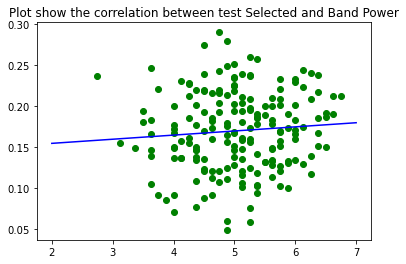

(0.08270360644960495, 0.26175751055372315)


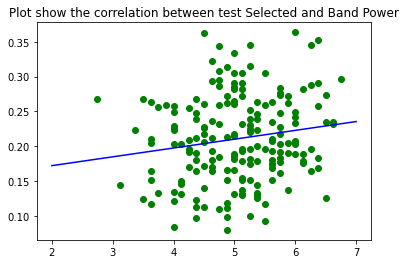

(0.16119453689139948, 0.028818263281367308)


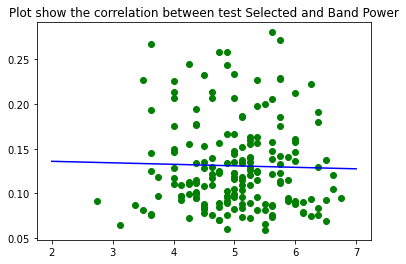

(-0.02637640524406381, 0.7252339667287536)


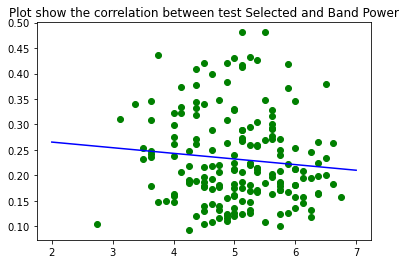

(-0.09978709256901748, 0.18015630122577744)


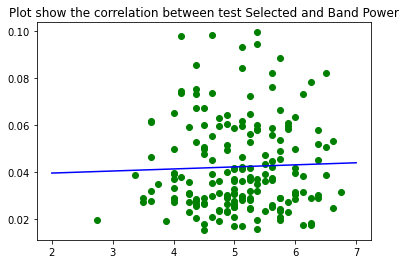

(0.03495818277072803, 0.6394231092995637)
EO, Emotionality, Brain Reagion:  Left_frontal


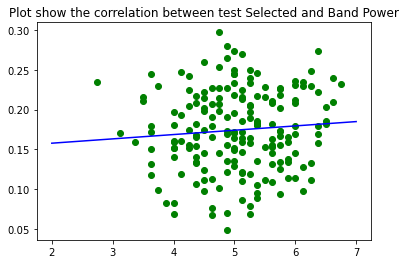

(0.08444584554889592, 0.25180669928076216)


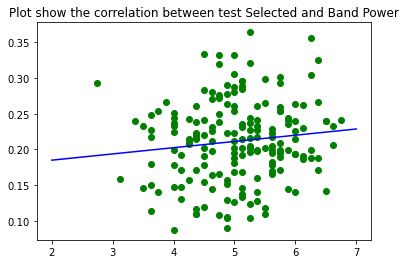

(0.12063942795676003, 0.10475372520457368)


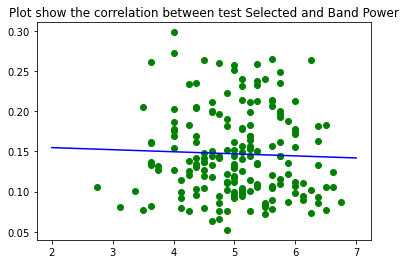

(-0.03788873562000638, 0.6125820882114552)


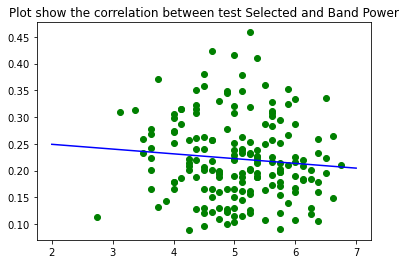

(-0.09388348623782054, 0.20999663803335494)


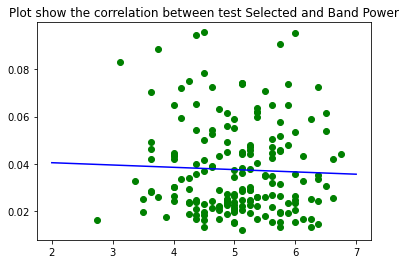

(-0.03976245359630721, 0.5940753015936772)
EO, Emotionality, Brain Reagion:  Right_frontal


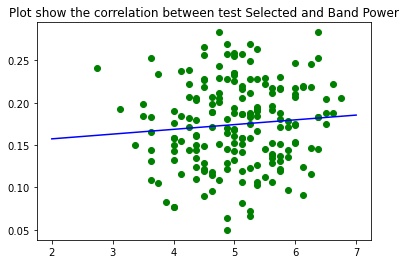

(0.08919216653673405, 0.22603604196376004)


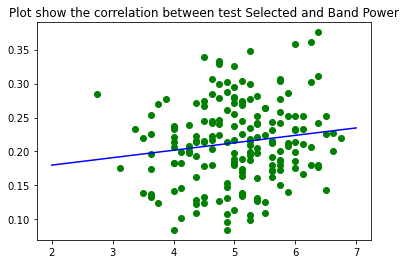

(0.14558770651333647, 0.04862003147383035)


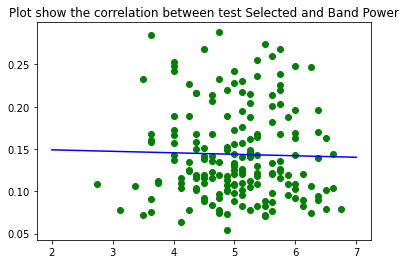

(-0.025641011541054977, 0.7318761379358759)


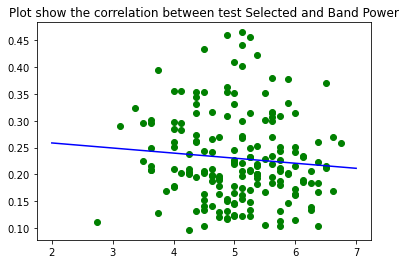

(-0.09206307242927901, 0.21643318987832946)


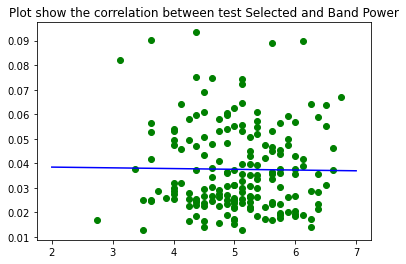

(-0.013618831241640601, 0.8552133735661094)
EO, Emotionality, Brain Reagion:  Left_temporal


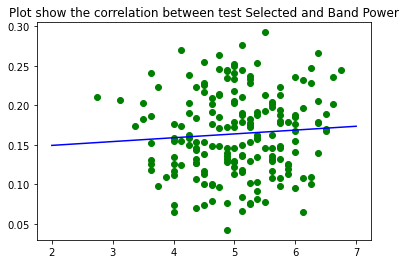

(0.07303511335787966, 0.32052928655976587)


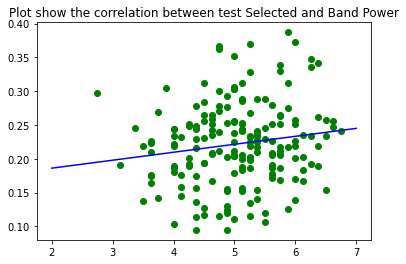

(0.15299487685464072, 0.03866978544839001)


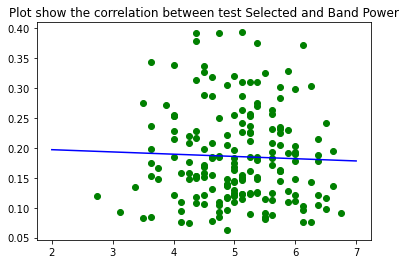

(-0.03810245663395848, 0.607593786114599)


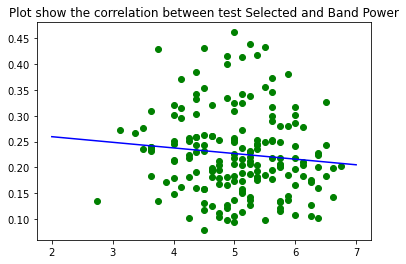

(-0.10657224204190352, 0.1521685974290748)


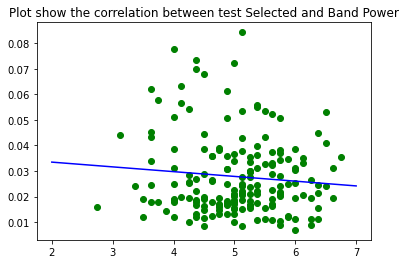

(-0.09612390029176993, 0.19927235623920384)
EO, Emotionality, Brain Reagion:  Left_central


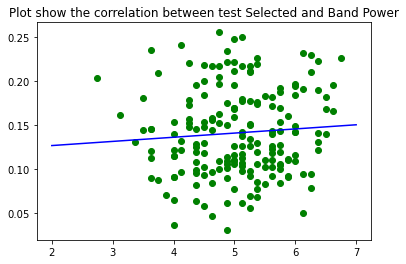

(0.07558913873977842, 0.30516663966986823)


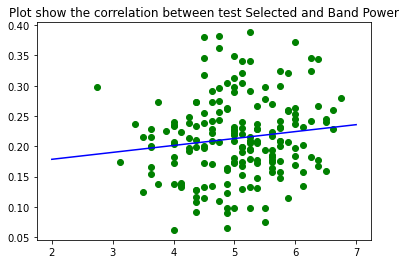

(0.1341398404967519, 0.0694663612506393)


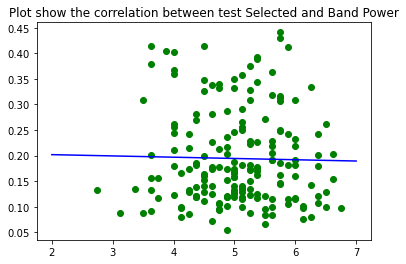

(-0.021264454431564137, 0.7744861587431443)


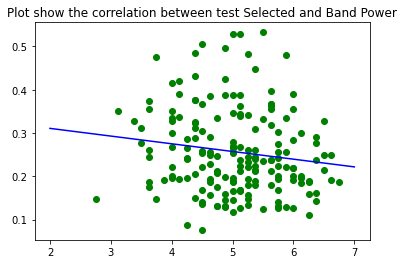

(-0.14493648385388982, 0.05092058290313124)


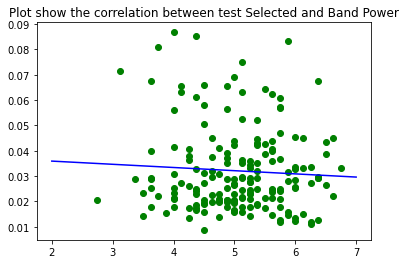

(-0.06053023487268913, 0.41825539557607866)
EO, Emotionality, Brain Reagion:  Left_parietal


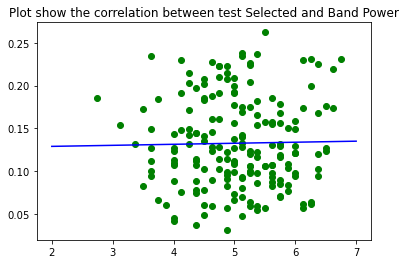

(0.01821886374072485, 0.8045296141913089)


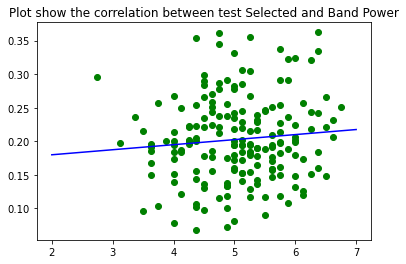

(0.0954939670341724, 0.1960069504824079)


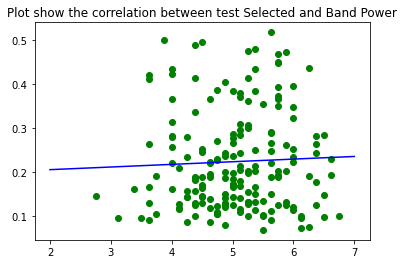

(0.04195438656368483, 0.5738819160937758)


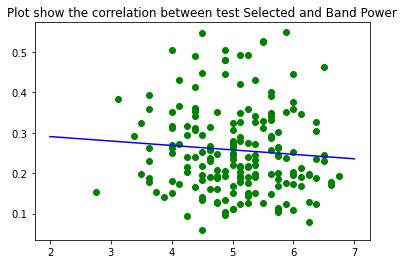

(-0.08175848551512799, 0.27254488547706845)


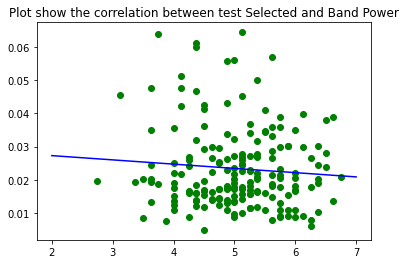

(-0.08287343428583697, 0.2633901618753647)
EO, Emotionality, Brain Reagion:  Left_Occipital


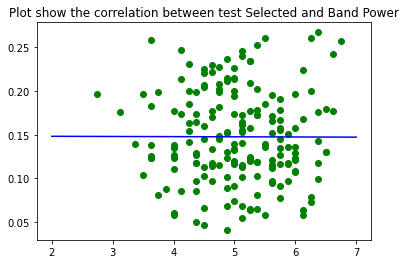

(-0.0028872812247953033, 0.9687163284083175)


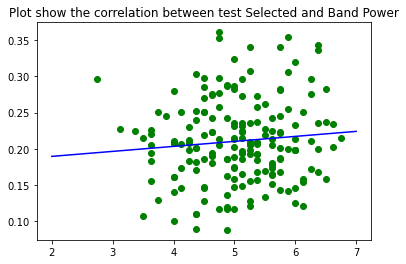

(0.09584147388985091, 0.1943770525787602)


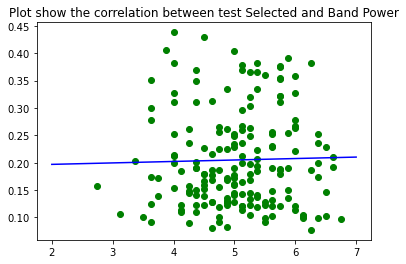

(0.02356104037705039, 0.7528914865246366)


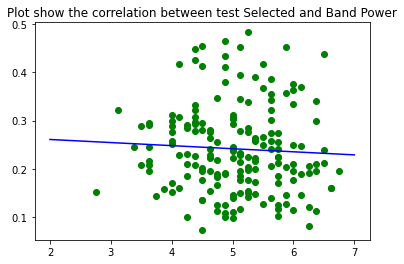

(-0.055989579829960216, 0.4540793009305223)


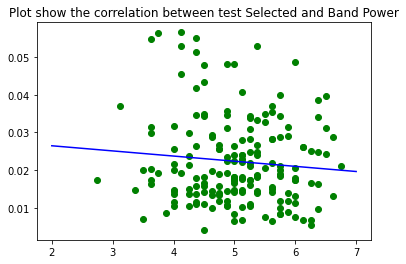

(-0.09346941907954501, 0.2107404251510947)
EO, Emotionality, Brain Reagion:  Right_Occipital


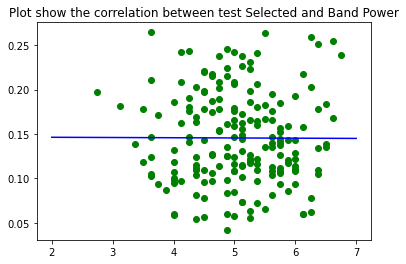

(-0.0039130780520620695, 0.9576108442623199)


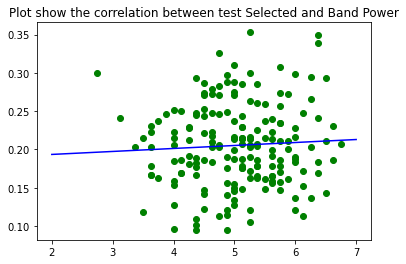

(0.05697537930811671, 0.4436227951056912)


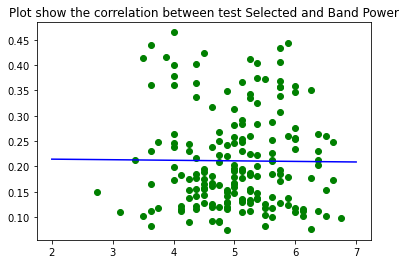

(-0.009264242906253994, 0.9012178736101749)


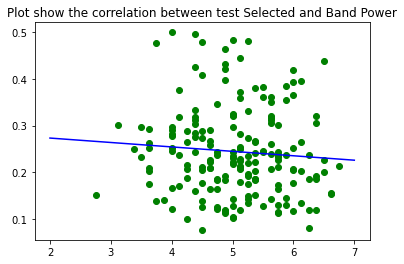

(-0.07932797830651865, 0.28443399470861386)


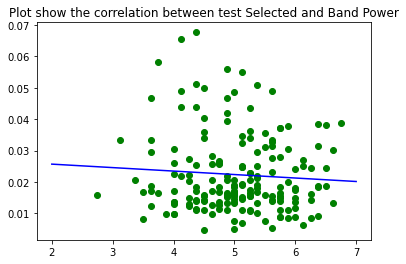

(-0.07037660606752129, 0.3464852532107761)
EO, Emotionality, Brain Reagion:  Right_parietal


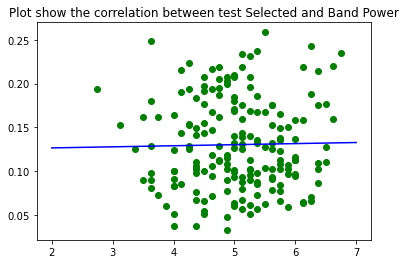

(0.018741596868869545, 0.7990387001942617)


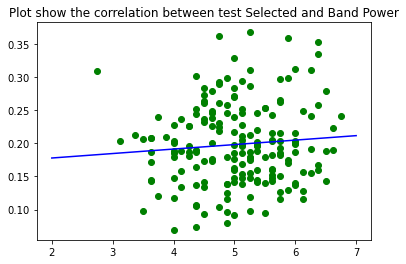

(0.08712702137695465, 0.23829169871562017)


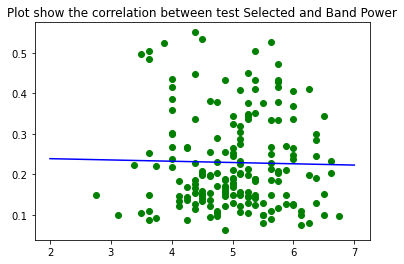

(-0.021459231450302957, 0.7743134924425533)


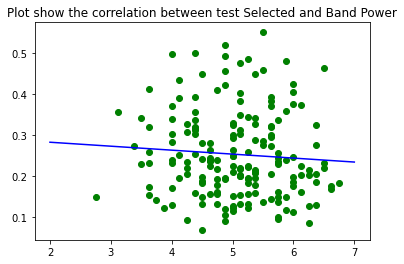

(-0.07348225106777798, 0.3255664963920495)


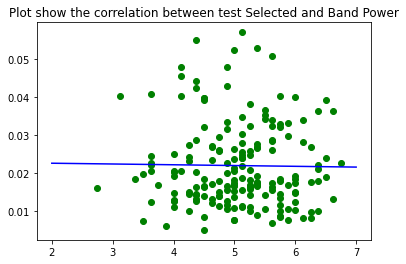

(-0.014516213293028976, 0.8453644530116513)
EO, Emotionality, Brain Reagion:  Right_temporal


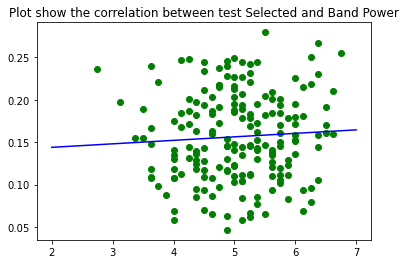

(0.0626732419062821, 0.39413905711724884)


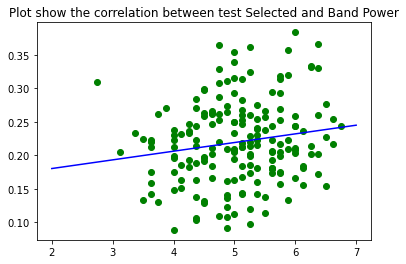

(0.16664967982812734, 0.023760782491410885)


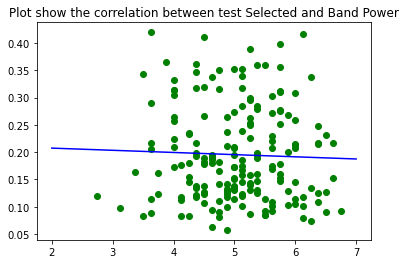

(-0.03607661721286904, 0.6258842477405582)


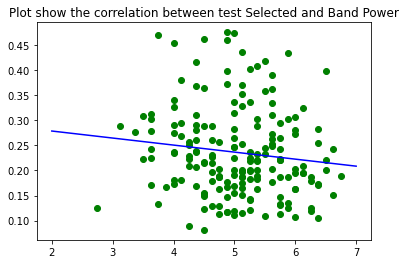

(-0.12549838851206968, 0.08960981814521933)


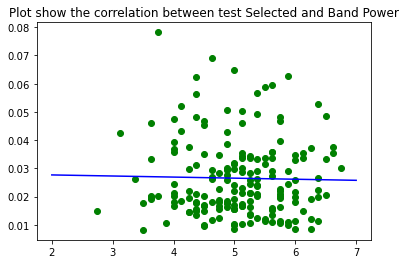

(-0.021812652111653733, 0.7706989328492743)
EO, Emotionality, Brain Reagion:  Posterior_midline


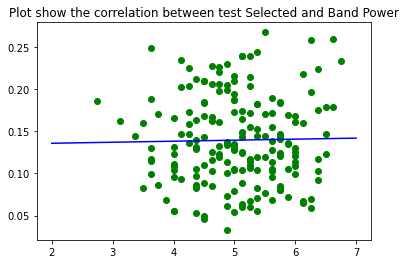

(0.018423808422261073, 0.8023756700482043)


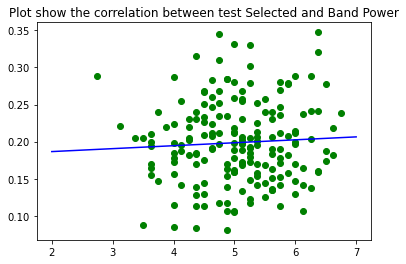

(0.05643447701319226, 0.44546483682085786)


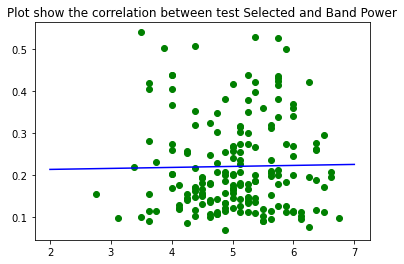

(0.016964376035271844, 0.8206823563162222)


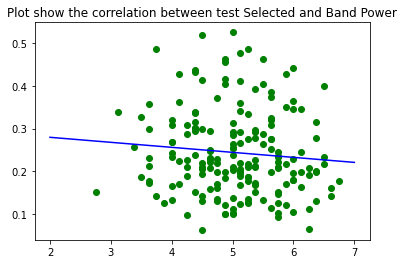

(-0.09309865588889325, 0.21002022145381366)


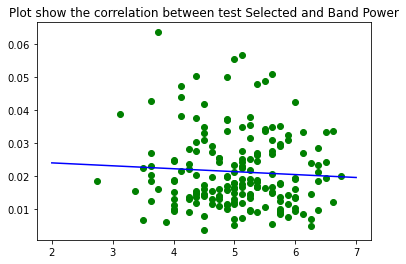

(-0.06165430346711371, 0.40574113130887185)
EO, Emotionality, Brain Reagion:  Right_central


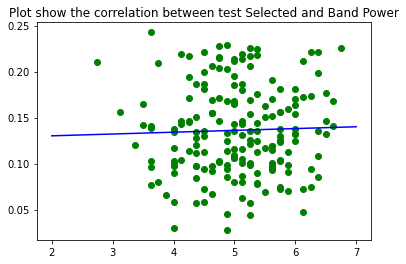

(0.03214711733900051, 0.6631376641317749)


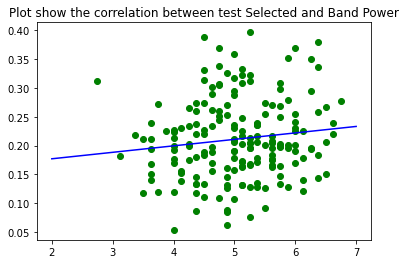

(0.12855473630059244, 0.08117205954614835)


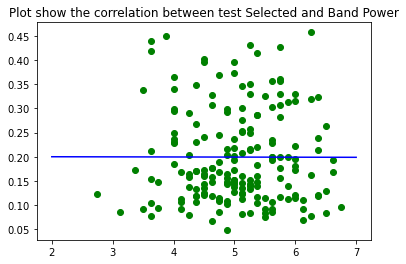

(-0.0019454051428210127, 0.9791483452986735)


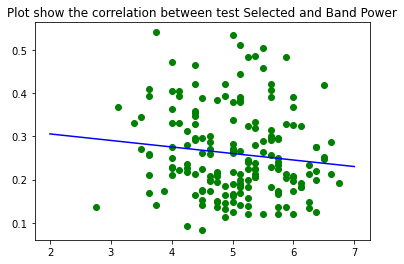

(-0.12115400627332186, 0.1042354137648412)


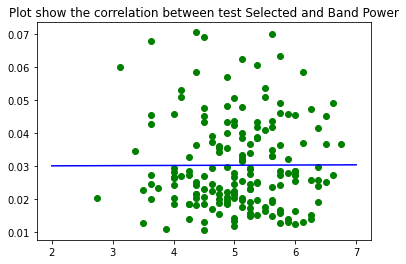

(0.003568758206034796, 0.9621845642785598)


In [10]:
save_corr_emotio_EO = []
for r in range(0,12):
    print('EO, Emotionality, Brain Reagion: ',lis_noms[r])
    cor = calcul(names, listEO_Names[r], TeiQueSF_emotionality, dataEO[r], 2, 7)
    save_corr_emotio_EO.append(cor)

EO, Well Being, Brain Reagion:  Anterior_midline


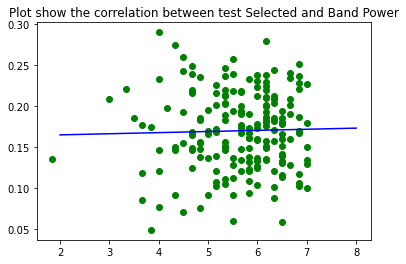

(0.026013772058808456, 0.7245019152061932)


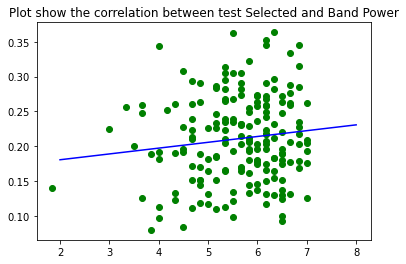

(0.12282129513848744, 0.09671946431298471)


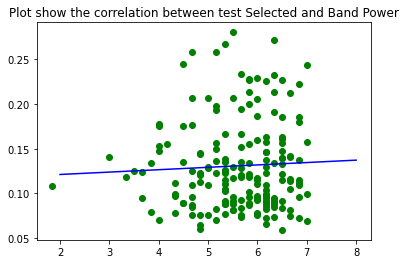

(0.04825622156831936, 0.5200361843541536)


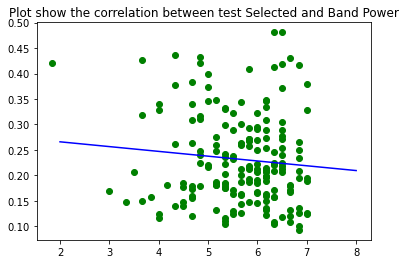

(-0.09646718513389924, 0.19515803794194295)


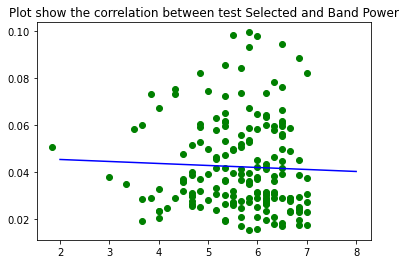

(-0.04027684780980634, 0.5893075386429238)
EO, Well Being, Brain Reagion:  Left_frontal


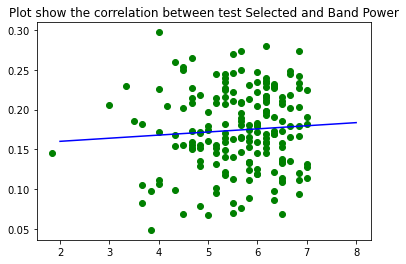

(0.07033903572035784, 0.3400776292609932)


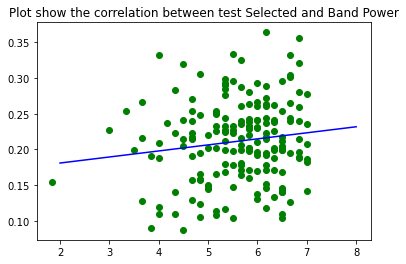

(0.13647431349865996, 0.06620124155723331)


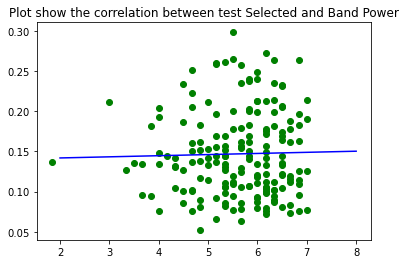

(0.023646120364795818, 0.7520281737517299)


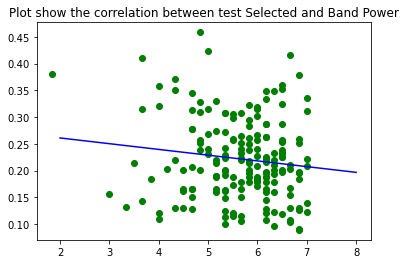

(-0.1279285331380178, 0.08700301173091532)


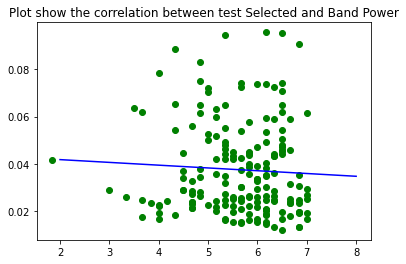

(-0.05552717906219445, 0.4565643732964013)
EO, Well Being, Brain Reagion:  Right_frontal


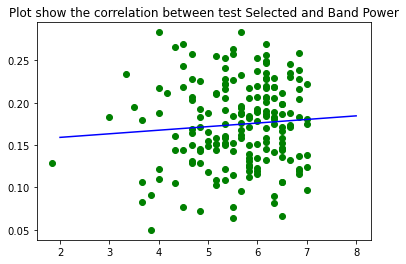

(0.07775243875394561, 0.2914933919180809)


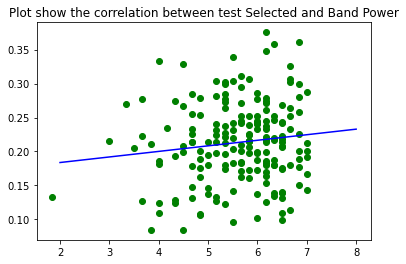

(0.12574919092023737, 0.08896571570522248)


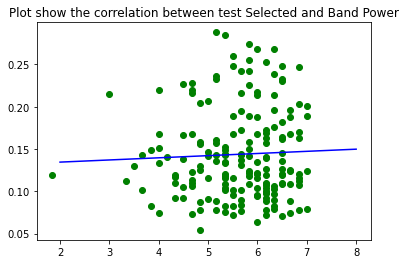

(0.042698987330500246, 0.5681781975498534)


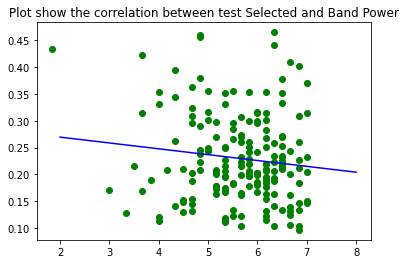

(-0.12053549849368944, 0.10505539410217155)


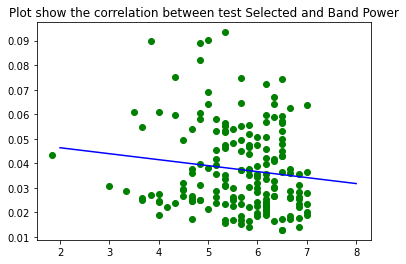

(-0.12832378146987017, 0.08427554855121187)
EO, Well Being, Brain Reagion:  Left_temporal


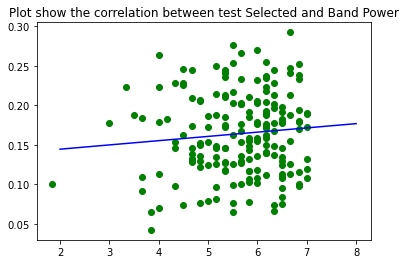

(0.09404304711463746, 0.20046228516270992)


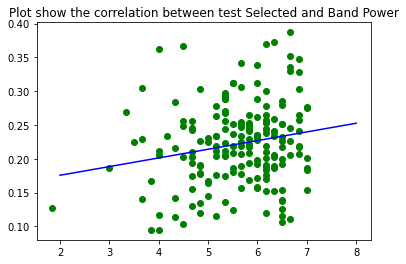

(0.19392256795395693, 0.00852899411722328)


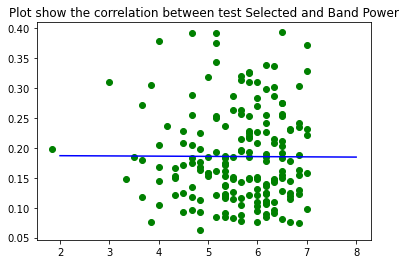

(-0.004628840391557587, 0.9502752832202682)


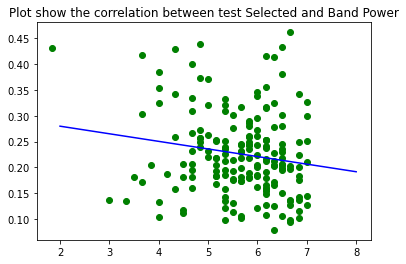

(-0.16440986507645927, 0.02656556188285479)


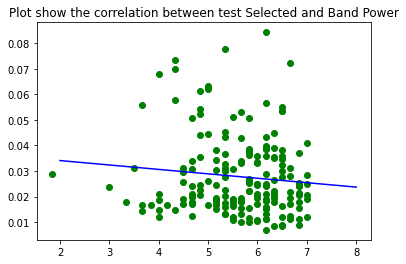

(-0.10374265787890351, 0.16577756805297386)
EO, Well Being, Brain Reagion:  Left_central


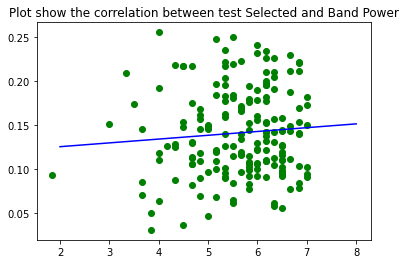

(0.07990014832741063, 0.27832888928252814)


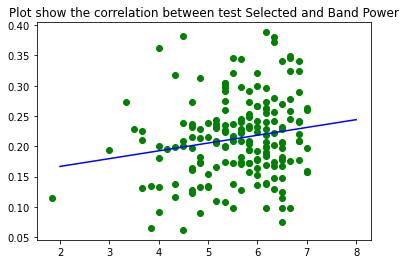

(0.17558249368568146, 0.01712388825686153)


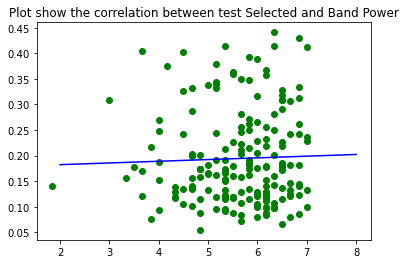

(0.03284246026756951, 0.6580693661494695)


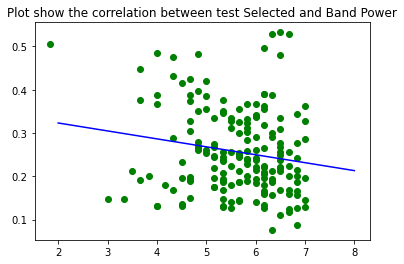

(-0.1705209318359064, 0.021364210580346224)


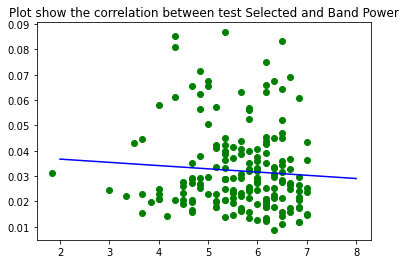

(-0.07084718968636866, 0.34326211723050437)
EO, Well Being, Brain Reagion:  Left_parietal


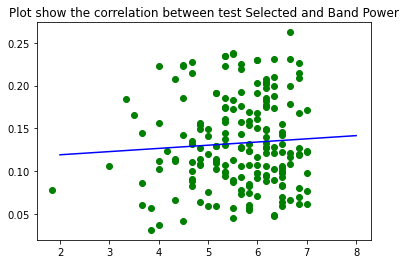

(0.06491121718333413, 0.3774378241242499)


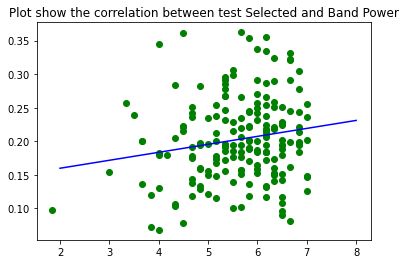

(0.17429655771343872, 0.017653200501781735)


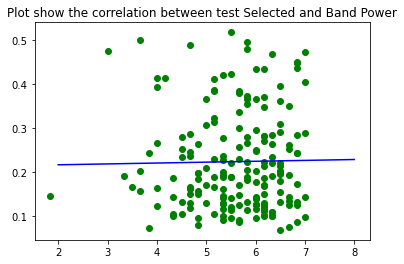

(0.016366074388060377, 0.8264289258101837)


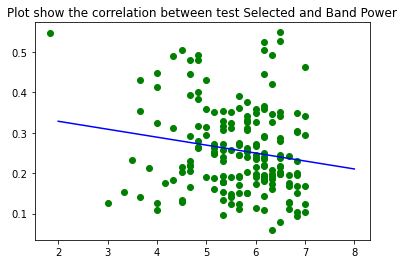

(-0.16696926426868378, 0.024268147998303142)


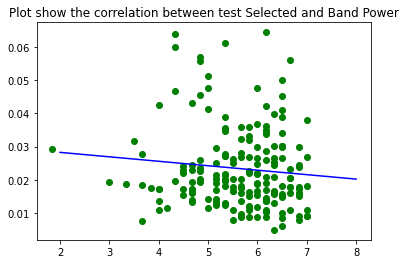

(-0.10010768989087707, 0.17635237505811008)
EO, Well Being, Brain Reagion:  Left_Occipital


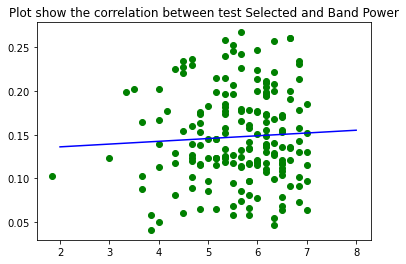

(0.05547588173608679, 0.4507798160263476)


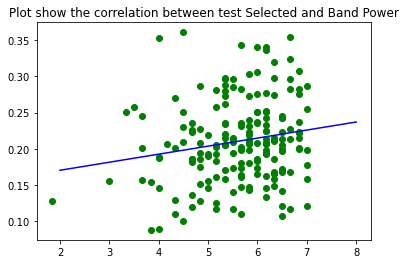

(0.17818950717810317, 0.015238314322752213)


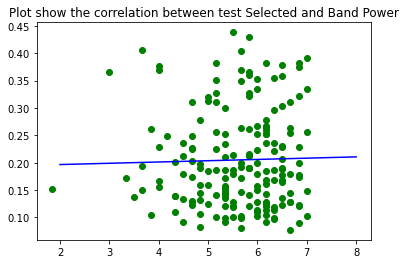

(0.02426502903401547, 0.7457573810785795)


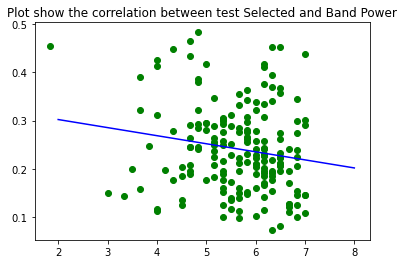

(-0.16767378396091553, 0.024058809676410185)


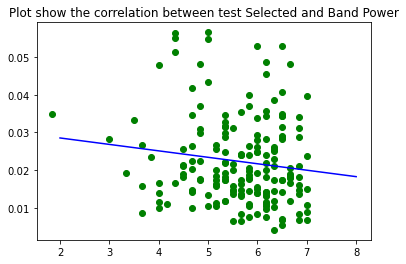

(-0.1348773014489716, 0.07024959646843139)
EO, Well Being, Brain Reagion:  Right_Occipital


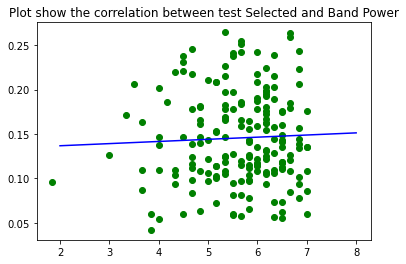

(0.042630344948664745, 0.5623760967603896)


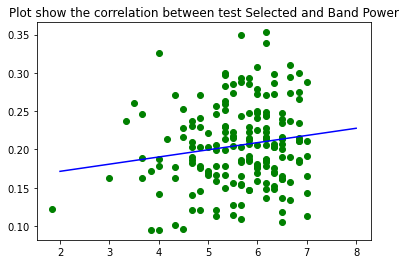

(0.1578365943949422, 0.0328478815425413)


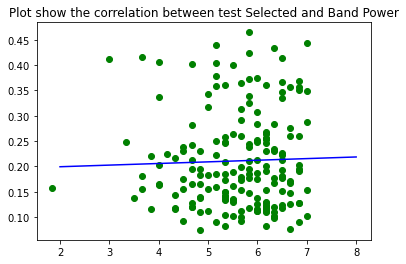

(0.031088779337621025, 0.676955217779626)


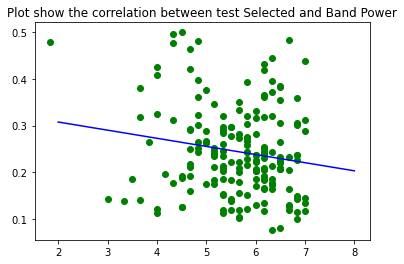

(-0.166585884365292, 0.02381519803546357)


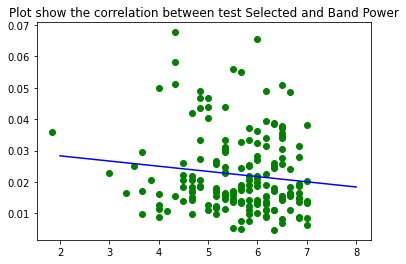

(-0.12164478499347613, 0.10282942233155004)
EO, Well Being, Brain Reagion:  Right_parietal


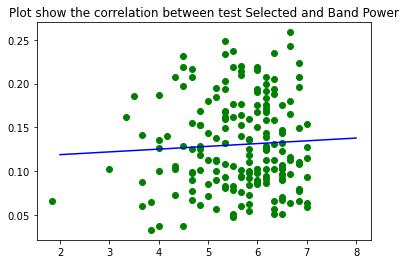

(0.05582486421959459, 0.4479321795409622)


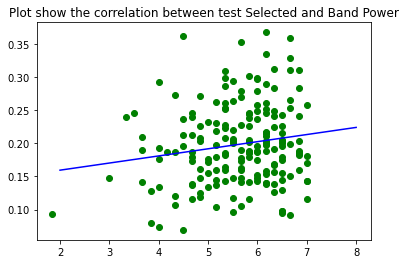

(0.1604232118851082, 0.029157525148573945)


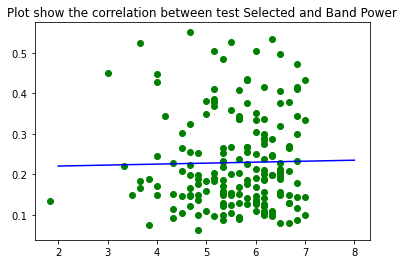

(0.018952016639413732, 0.8000908197061265)


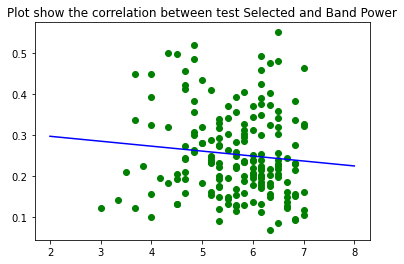

(-0.09951509593980905, 0.18257312421432045)


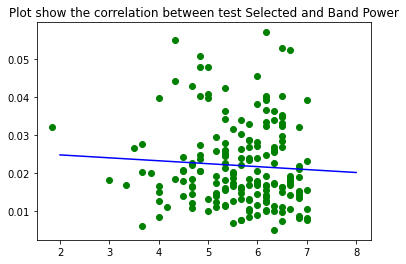

(-0.06367594033091704, 0.39179911410829743)
EO, Well Being, Brain Reagion:  Right_temporal


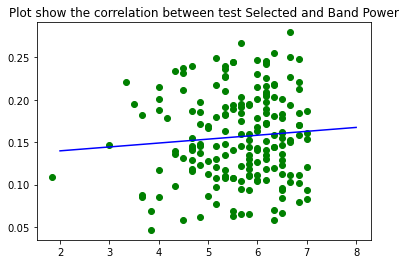

(0.08112798314286909, 0.26968413054292245)


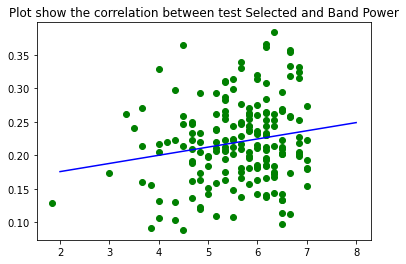

(0.1814152841006593, 0.01371846402059755)


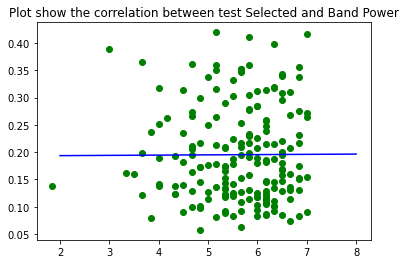

(0.004953005480471256, 0.9466517952133595)


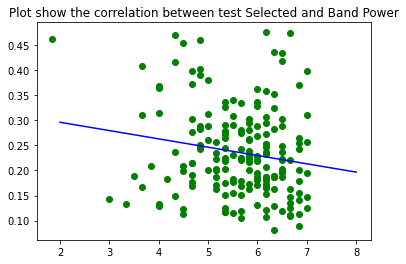

(-0.16962503184371927, 0.02133897484231812)


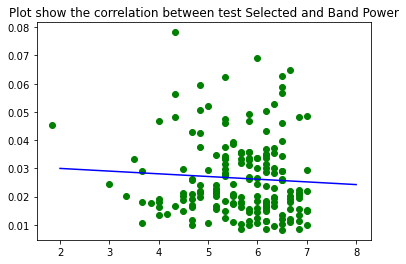

(-0.06363816619690532, 0.394716330016866)
EO, Well Being, Brain Reagion:  Posterior_midline


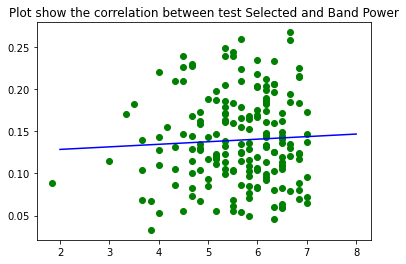

(0.053087262963131814, 0.4705411751975223)


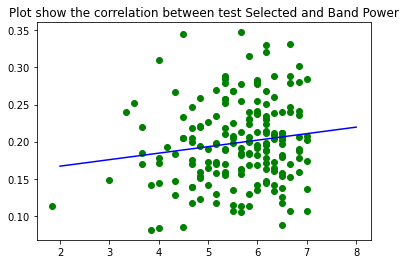

(0.14427669798770199, 0.05007320663714219)


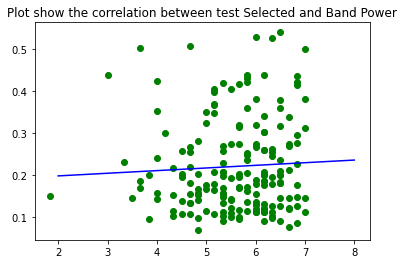

(0.05225014722887785, 0.4848263878768039)


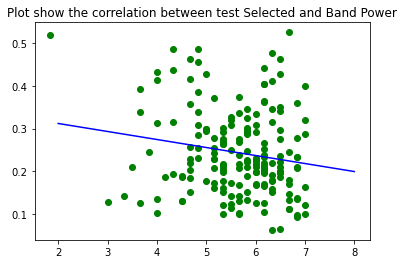

(-0.17014613058978154, 0.021293523531158536)


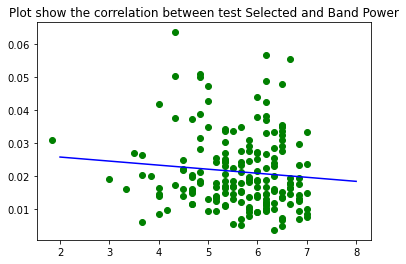

(-0.09854853166920319, 0.18321879440470784)
EO, Well Being, Brain Reagion:  Right_central


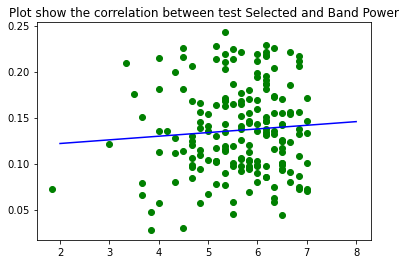

(0.07464952811073831, 0.3112348805910873)


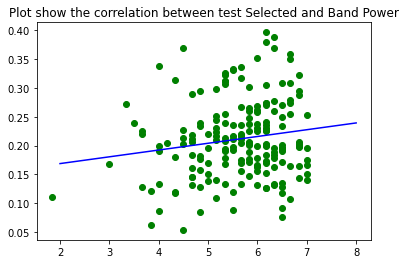

(0.15557059764213454, 0.03446930055970443)


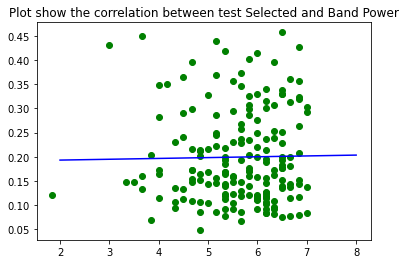

(0.016271211603604972, 0.8269467774619568)


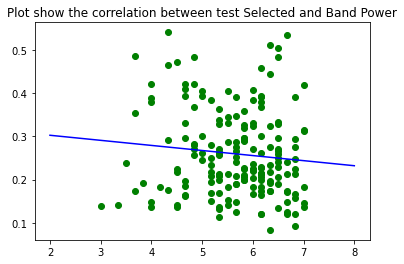

(-0.10235123321304022, 0.17035674115439756)


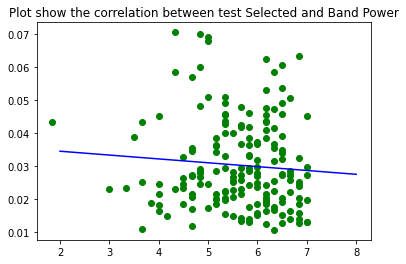

(-0.07893494293226375, 0.2935716066739452)


In [11]:
save_corr_well_EO = []
for r in range(0,12):
    print('EO, Well Being, Brain Reagion: ',lis_noms[r])
    cor = calcul(names, listEO_Names[r], TeiQueSF_wellBeing, dataEO[r], 2, 8)
    save_corr_well_EO.append(cor)

EC, Emotionality, Brain Reagion:  Anterior_midline


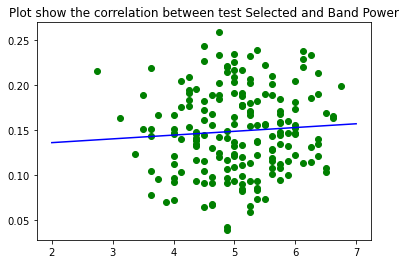

(0.07052556873686794, 0.33879537093573847)


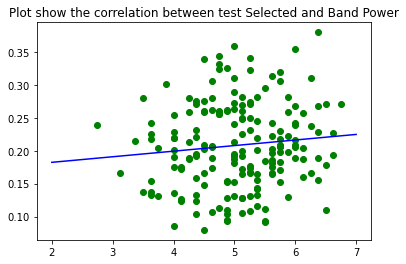

(0.10406692386510624, 0.1620933977386499)


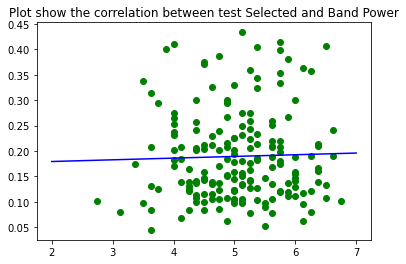

(0.029792193566829384, 0.6897177604755512)


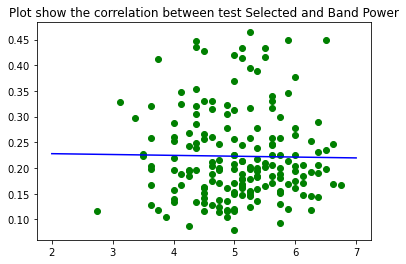

(-0.015143582902238557, 0.8392115239125492)


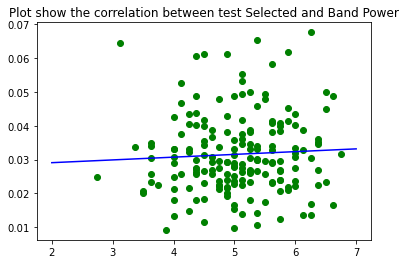

(0.054744247265849685, 0.46545016882657303)
EC, Emotionality, Brain Reagion:  Left_frontal


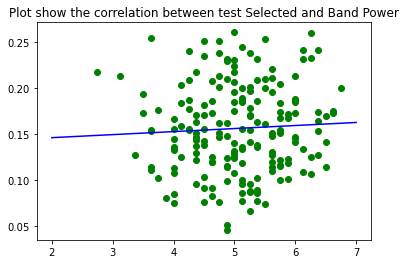

(0.05355585113606431, 0.46783767004787674)


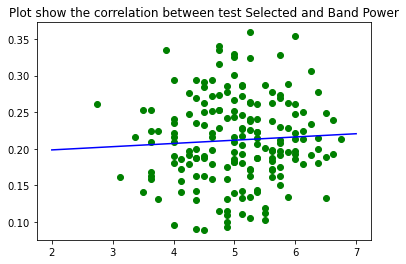

(0.059617743268112845, 0.4253190483382019)


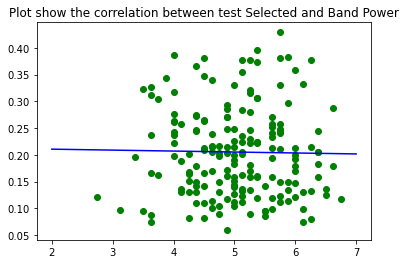

(-0.016921177499833486, 0.8201490873678348)


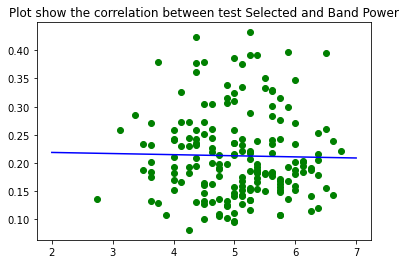

(-0.020557055631137806, 0.7829719402480266)


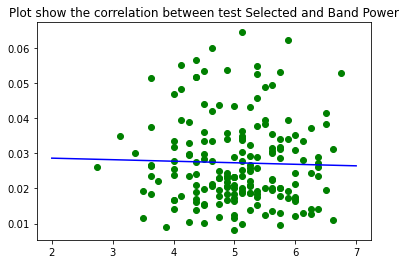

(-0.028435896252203552, 0.7039511633744616)
EC, Emotionality, Brain Reagion:  Right_frontal


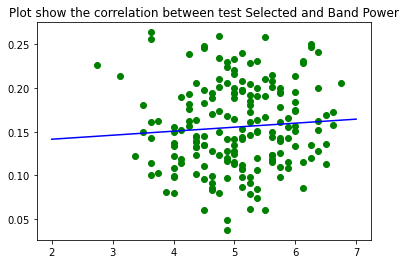

(0.07437825102793105, 0.31168653099338123)


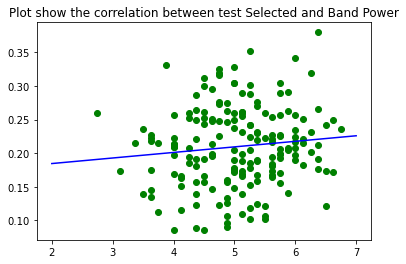

(0.1105996593537277, 0.13718537915545906)


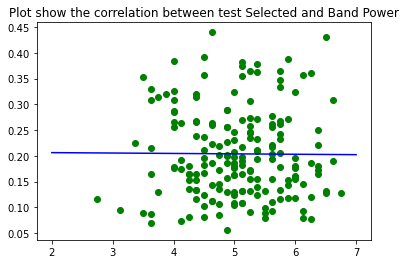

(-0.007346756845735423, 0.9209391844297373)


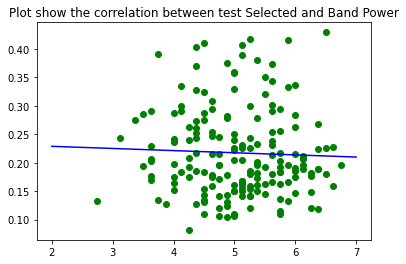

(-0.039145369555864694, 0.6008357670264447)


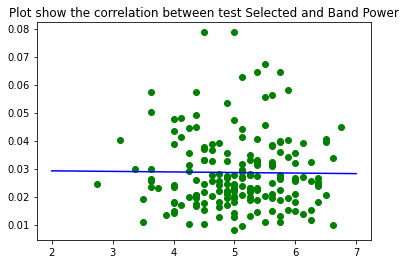

(-0.011982311281178153, 0.8724539664233776)
EC, Emotionality, Brain Reagion:  Left_temporal


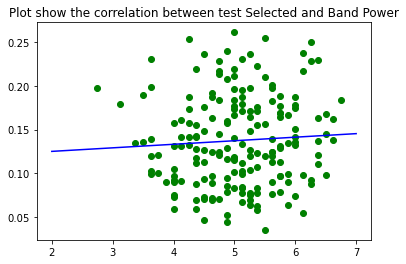

(0.061857215190076545, 0.40161724396483156)


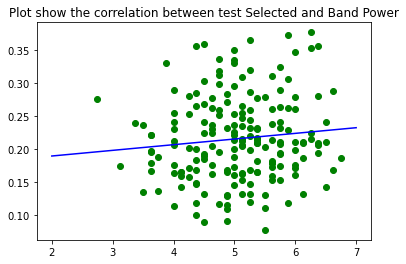

(0.10531387399137766, 0.15367062656582645)


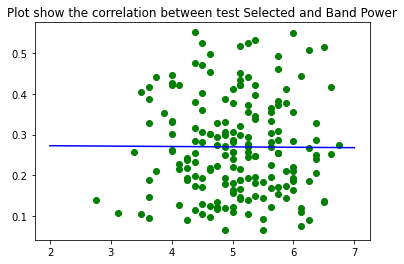

(-0.006382065812061747, 0.9312931208315558)


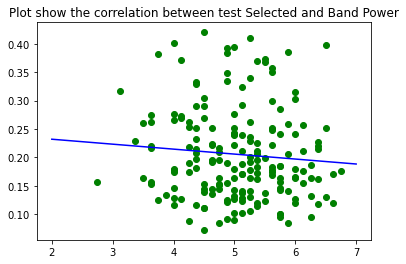

(-0.08629574550690347, 0.24411234119209463)


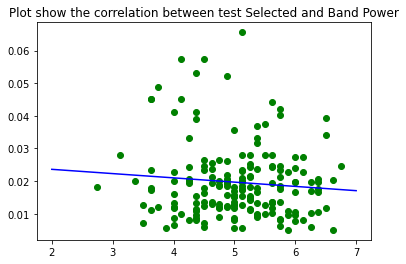

(-0.09263753360275678, 0.2161369312791335)
EC, Emotionality, Brain Reagion:  Left_central


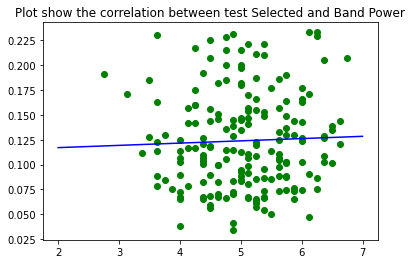

(0.03711333929773099, 0.615020788793828)


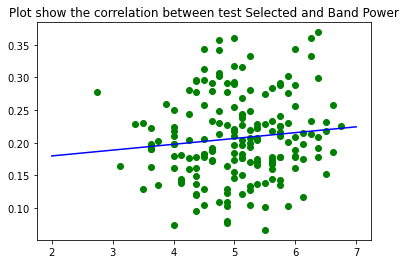

(0.11092403719552246, 0.13386772609435224)


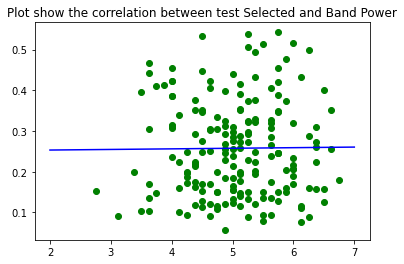

(0.009833599019451801, 0.8943135370218921)


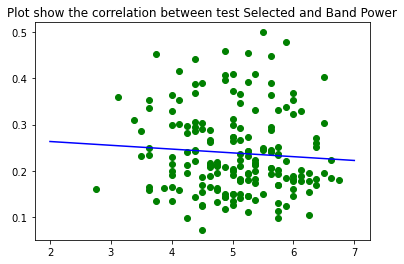

(-0.07316798553945372, 0.32764547637545355)


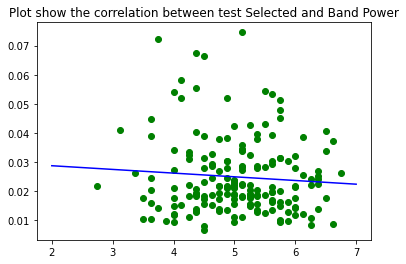

(-0.07734864539343653, 0.30068690839255663)
EC, Emotionality, Brain Reagion:  Left_parietal


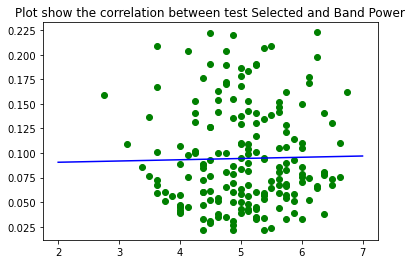

(0.019733555712926686, 0.7892061836324452)


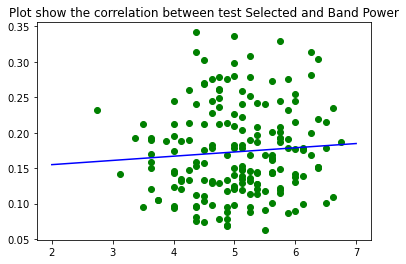

(0.07472264234180254, 0.31341129680247776)


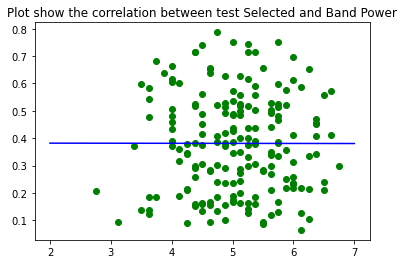

(-0.0011709840057932833, 0.9873097012952888)


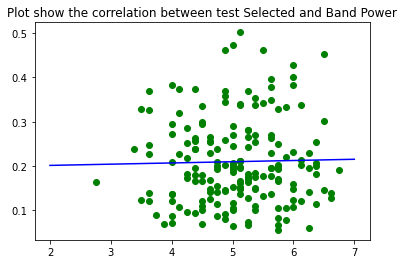

(0.022256523212744225, 0.766803178782968)


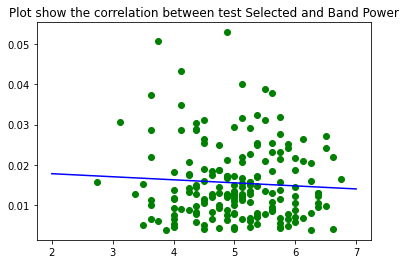

(-0.0646867878601297, 0.3843101614799391)
EC, Emotionality, Brain Reagion:  Left_Occipital


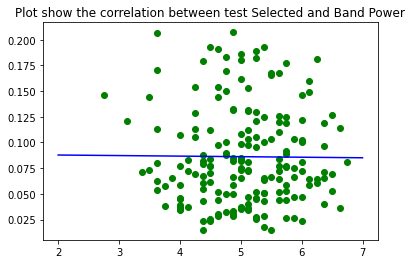

(-0.008986932300785105, 0.9038951017136452)


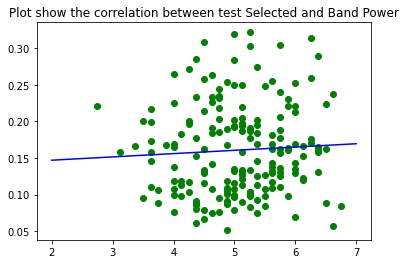

(0.057377570837379176, 0.4404066598156941)


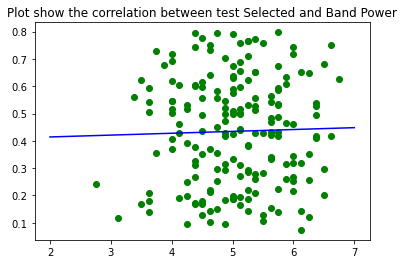

(0.02734782797986884, 0.7102369551904257)


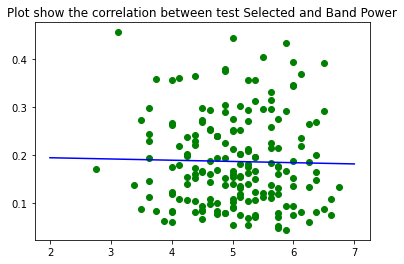

(-0.021766816252105164, 0.7705452684179198)


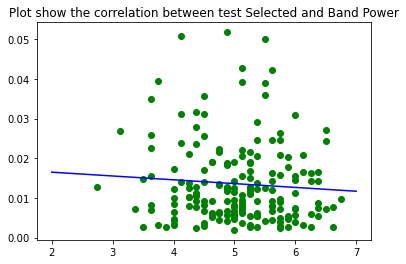

(-0.07466145775924896, 0.31514560883065834)
EC, Emotionality, Brain Reagion:  Right_Occipital


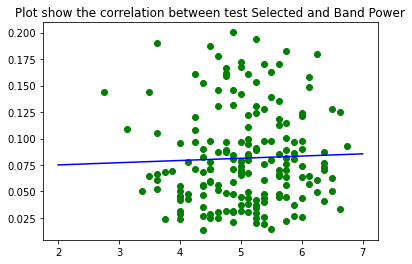

(0.03647459453172962, 0.6249538614418882)


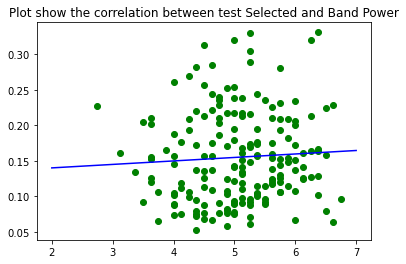

(0.06079232242791493, 0.4123494828459767)


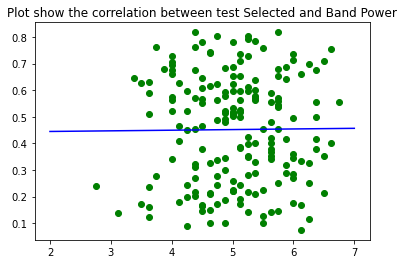

(0.009226629090903778, 0.9002631589221485)


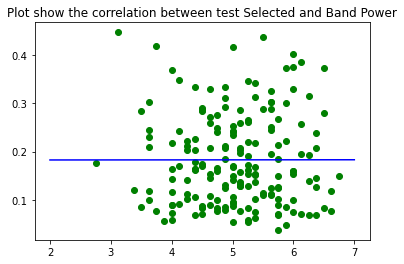

(0.000725824677896926, 0.992241137190654)


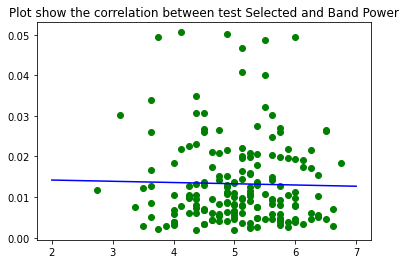

(-0.022836289011628725, 0.7596079544660204)
EC, Emotionality, Brain Reagion:  Right_parietal


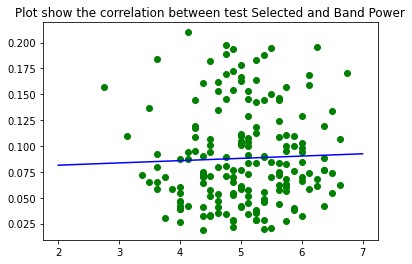

(0.03697338787823239, 0.6192529041531406)


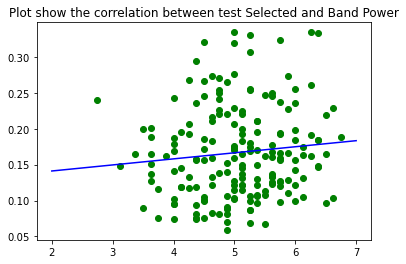

(0.10447183980559134, 0.15814657391589498)


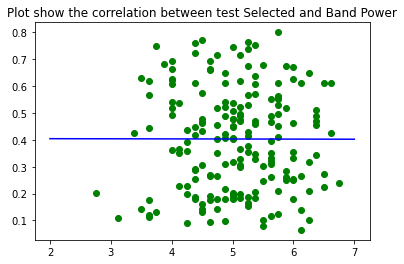

(-0.0016599599995660097, 0.9820112838356693)


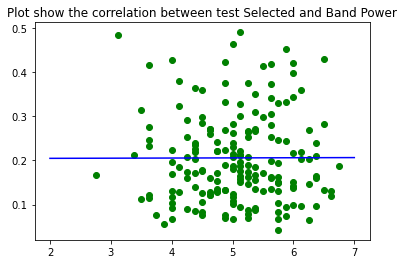

(0.0026854171171446922, 0.9712993337853689)


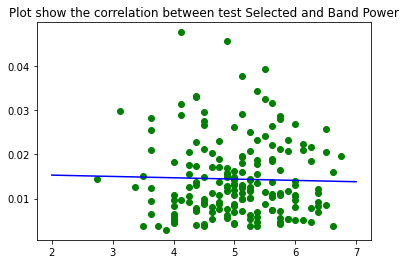

(-0.027121667788584897, 0.7162783111606228)
EC, Emotionality, Brain Reagion:  Right_temporal


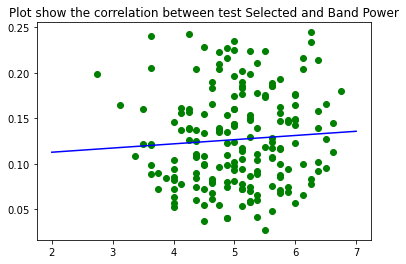

(0.06997566538179535, 0.3425843417716799)


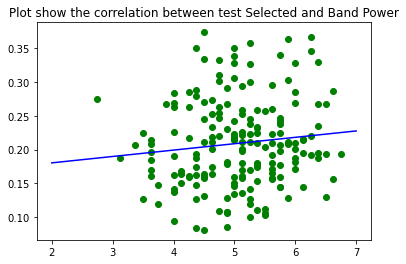

(0.11372234652363494, 0.1232409293445794)


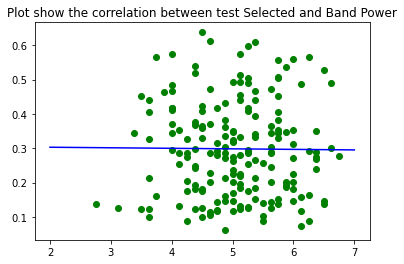

(-0.008909195636856241, 0.9041985936646425)


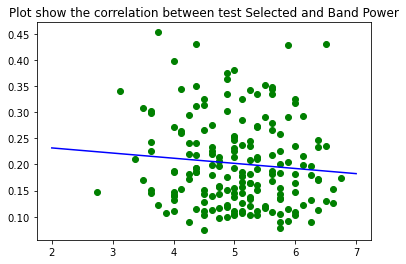

(-0.09449654724164913, 0.20574710854178802)


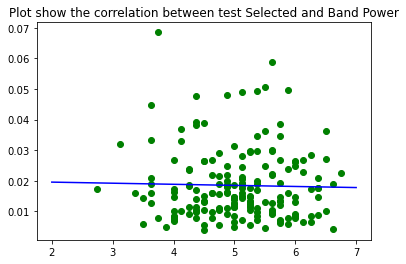

(-0.02479989506299729, 0.7403515131340573)
EC, Emotionality, Brain Reagion:  Posterior_midline


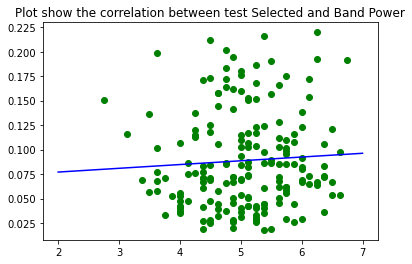

(0.06102978063803002, 0.41052273076846546)


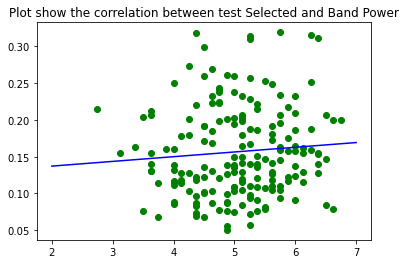

(0.08313092662374241, 0.2632227869166002)


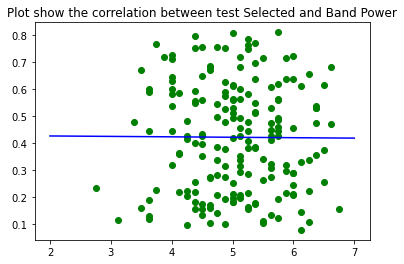

(-0.006329788944565187, 0.9314830834849567)


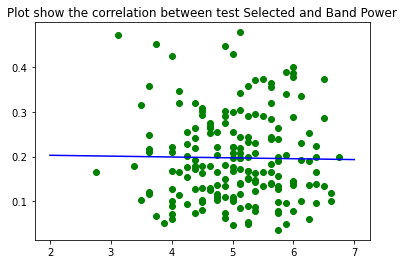

(-0.015572168313108918, 0.8342721112404452)


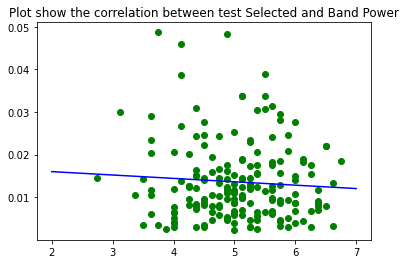

(-0.06869853013965849, 0.35545466832146744)
EC, Emotionality, Brain Reagion:  Right_central


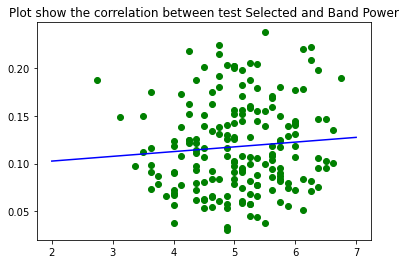

(0.08279734863479331, 0.2625187627403507)


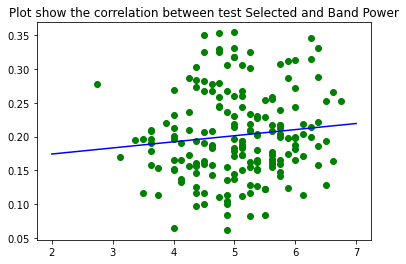

(0.11092043405351365, 0.1338804367314973)


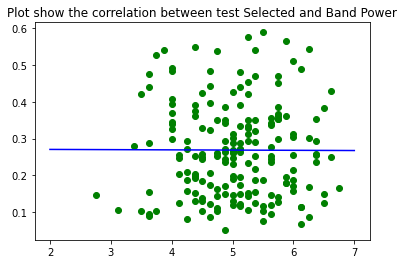

(-0.003736974916329308, 0.9597366816077988)


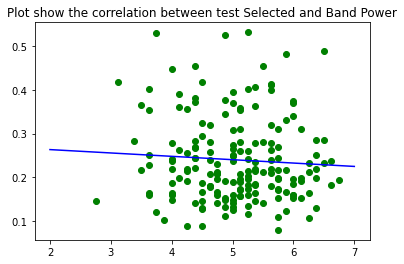

(-0.06381485193756692, 0.3934024482149103)


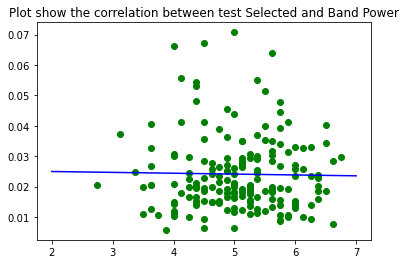

(-0.018113367599475298, 0.8087631330245267)


In [12]:
save_corr_emotio_EC = []
for r in range(0,12):
    print('EC, Emotionality, Brain Reagion: ',lis_noms[r])
    cor = calcul(names, listEC_Names[r], TeiQueSF_emotionality, dataEC[r], 2, 7)
    save_corr_emotio_EC.append(cor)

EC, Well Being, Brain Reagion:  Anterior_midline


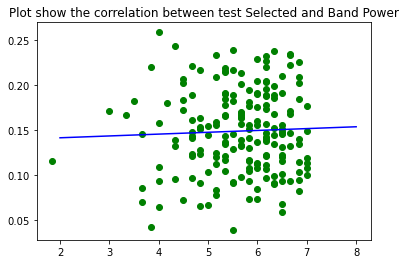

(0.04004425395543963, 0.5873591571041685)


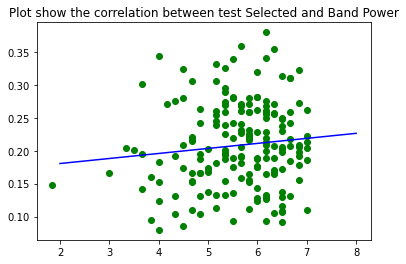

(0.10820252085093998, 0.14596112402945402)


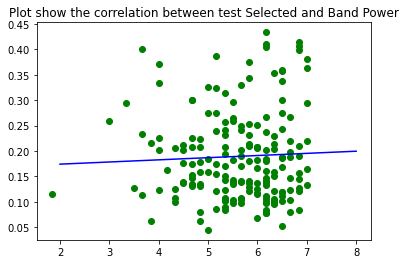

(0.04434479530264589, 0.5522348132668131)


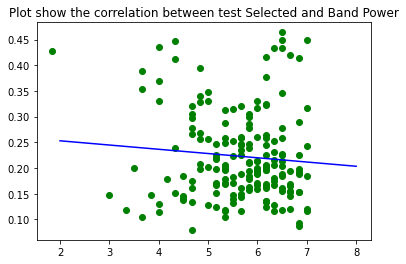

(-0.08671344551814905, 0.2444393588431831)


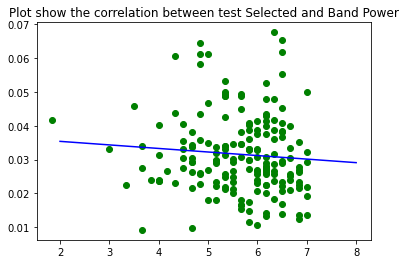

(-0.08155657905064222, 0.27642405491518324)
EC, Well Being, Brain Reagion:  Left_frontal


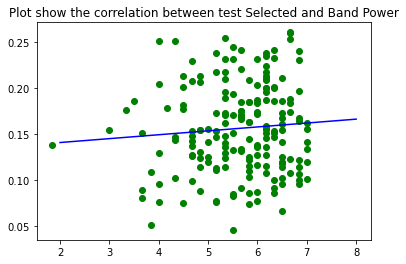

(0.08021566105302927, 0.2764292933573225)


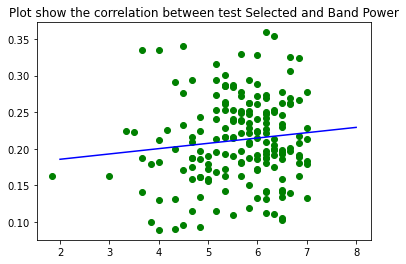

(0.11369161127012922, 0.12753054583862036)


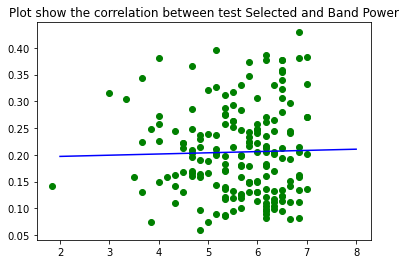

(0.024779619473555715, 0.7391594299464225)


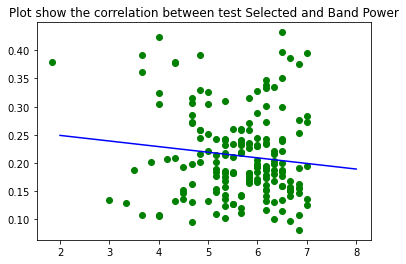

(-0.11882288439149039, 0.11012558988337208)


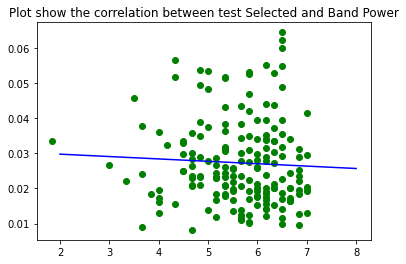

(-0.0509056067216413, 0.4961490004576064)
EC, Well Being, Brain Reagion:  Right_frontal


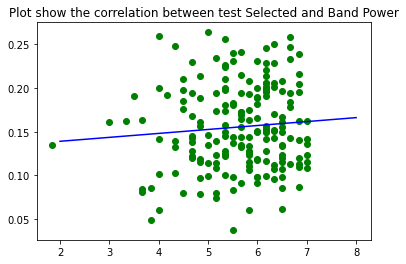

(0.08463599276622562, 0.24944967830518444)


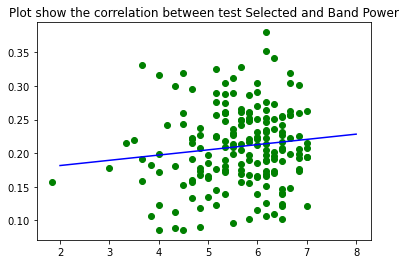

(0.12013381058368626, 0.10622777910867409)


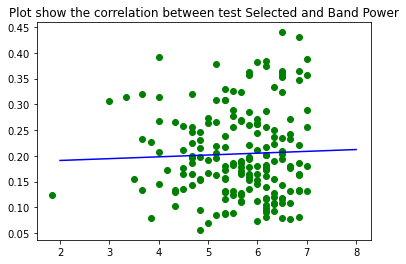

(0.03806199164819446, 0.6069887039568564)


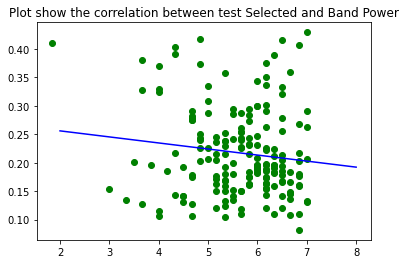

(-0.12566085339193106, 0.09187878859185619)


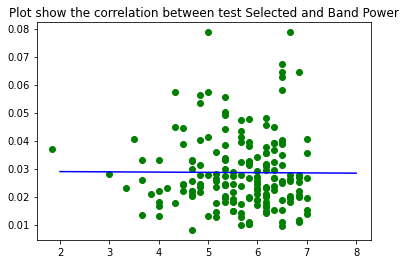

(-0.00654387522030031, 0.930135478716221)
EC, Well Being, Brain Reagion:  Left_temporal


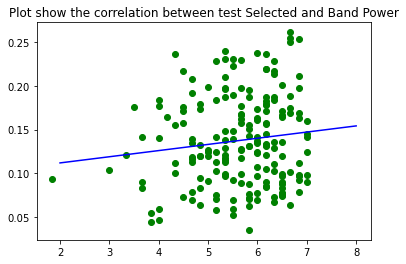

(0.12460979502908445, 0.0901502237452857)


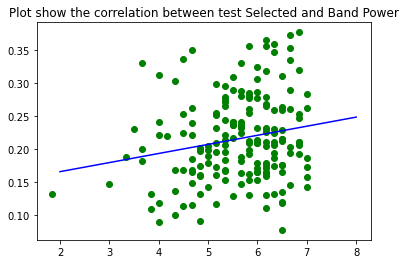

(0.19542344598996067, 0.007680918528256867)


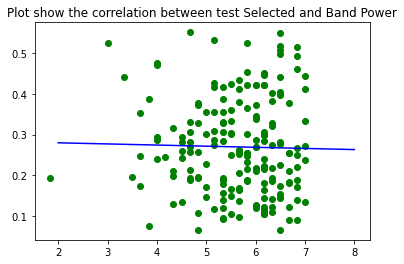

(-0.021491871861416677, 0.7715306705244734)


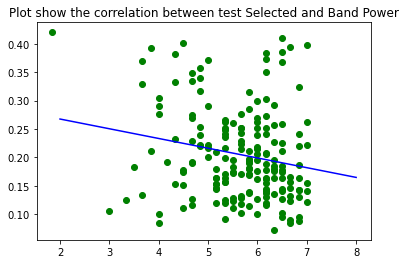

(-0.19544499854080719, 0.007842674927397247)


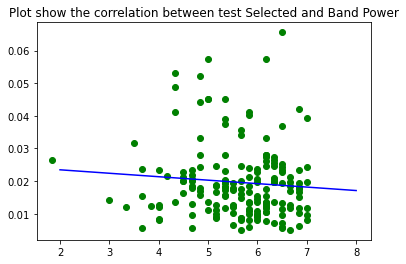

(-0.08641719490644645, 0.24870920182946618)
EC, Well Being, Brain Reagion:  Left_central


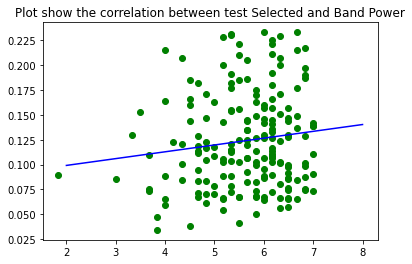

(0.12920557957030265, 0.07881134350553567)


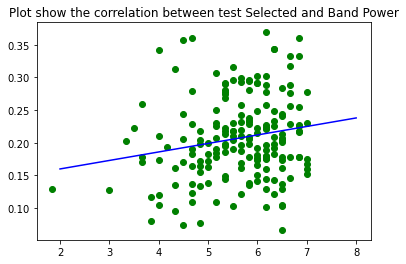

(0.18716421522938403, 0.010957873625552783)


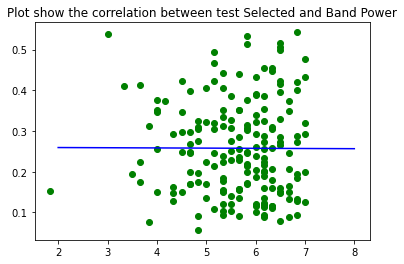

(-0.0036967222405718753, 0.9601700169174393)


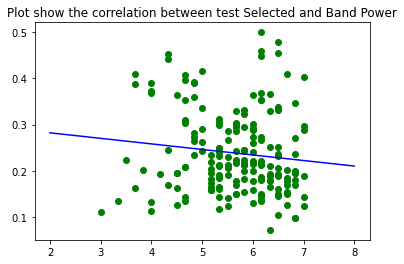

(-0.11605686405331793, 0.11974851129862965)


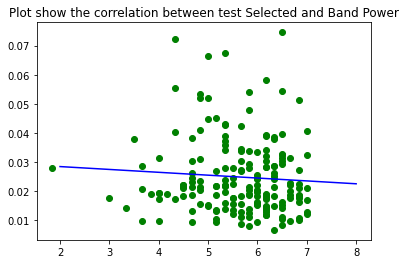

(-0.0693248204397244, 0.35375799898982135)
EC, Well Being, Brain Reagion:  Left_parietal


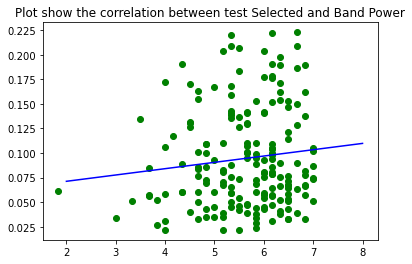

(0.1153974111330406, 0.11677715824212194)


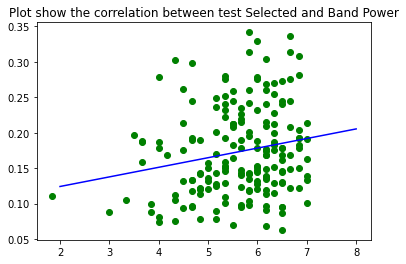

(0.19612711482072112, 0.007625152146451477)


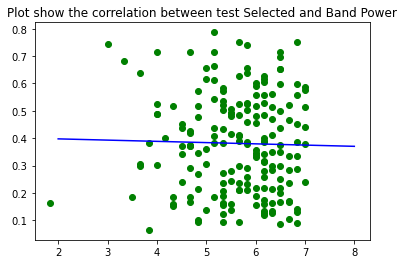

(-0.023070475867251083, 0.7539689066660129)


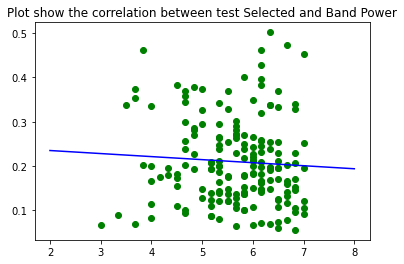

(-0.0614570236336118, 0.41246512423225484)


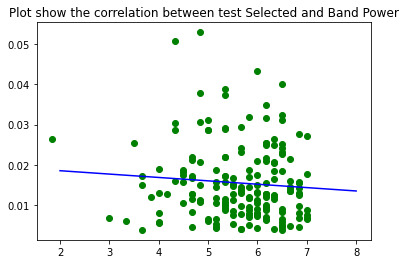

(-0.08242773190427209, 0.26729649258213745)
EC, Well Being, Brain Reagion:  Left_Occipital


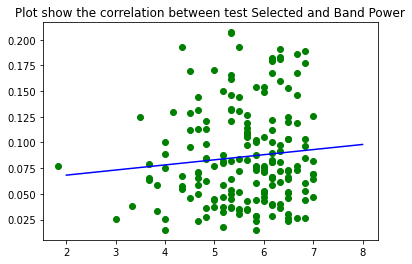

(0.09685570137215295, 0.19212093569079078)


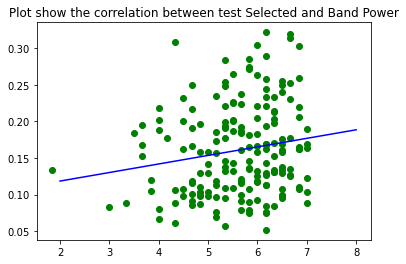

(0.17262791578816283, 0.019447659695307044)


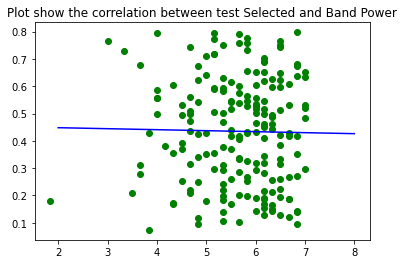

(-0.016939063571712498, 0.8180128574290422)


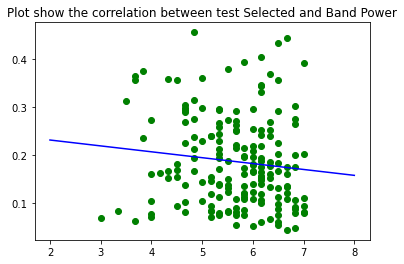

(-0.11345248380967846, 0.12727403846022362)


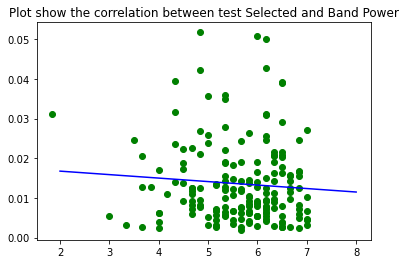

(-0.07842669077552351, 0.2912912249763486)
EC, Well Being, Brain Reagion:  Right_Occipital


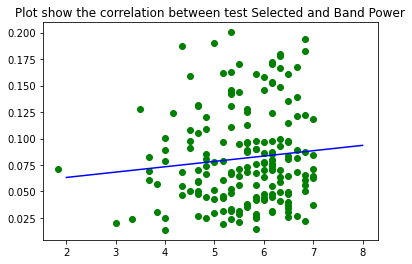

(0.10334435899760223, 0.165043933454627)


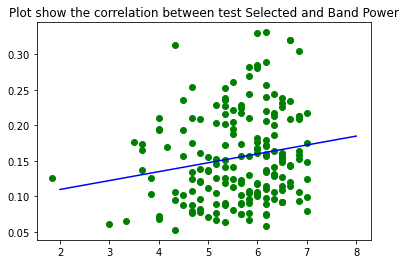

(0.17990374799392483, 0.014538539759799098)


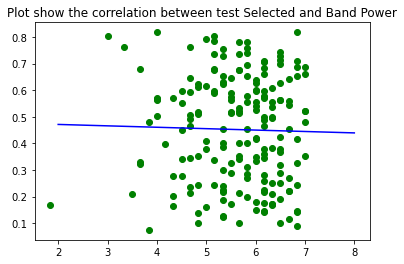

(-0.02402467182020858, 0.7441393582438459)


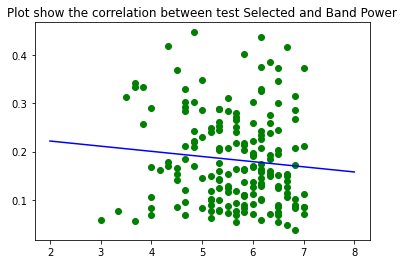

(-0.09860045289027042, 0.18541765260822804)


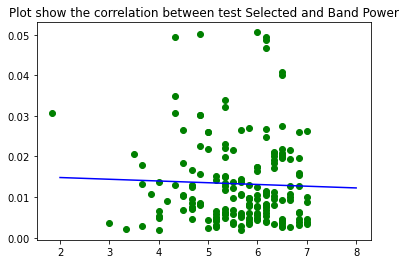

(-0.03689410555046592, 0.6209758579934471)
EC, Well Being, Brain Reagion:  Right_parietal


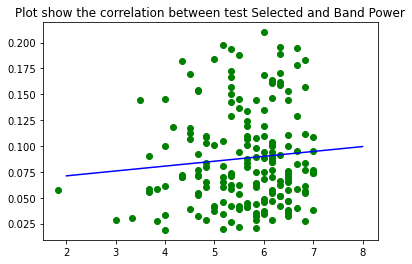

(0.09253184009229833, 0.21282129613053166)


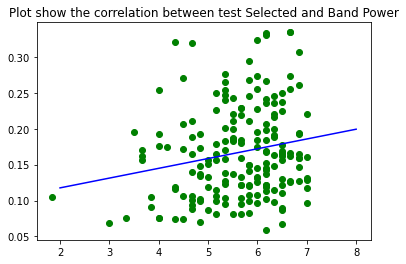

(0.19510983381396682, 0.007951563204783596)


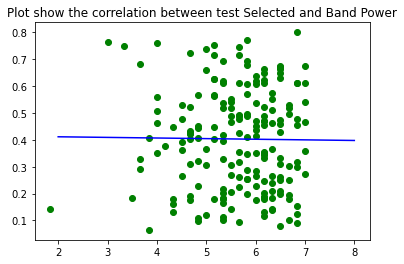

(-0.011083362918255612, 0.8803298524157583)


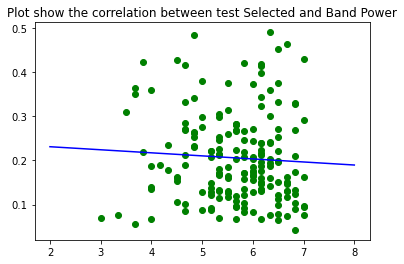

(-0.059775842755226696, 0.4227952956555925)


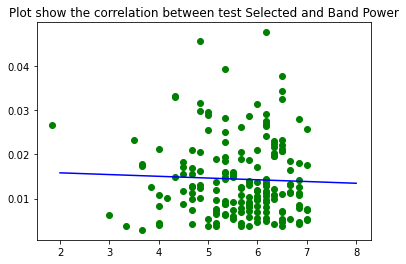

(-0.04113911850047937, 0.5813549263718418)
EC, Well Being, Brain Reagion:  Right_temporal


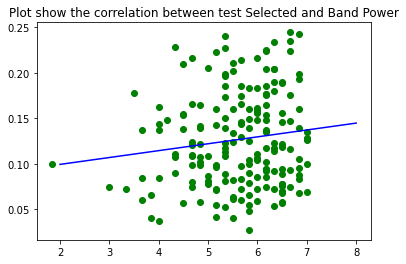

(0.133223213526944, 0.06986837313375133)


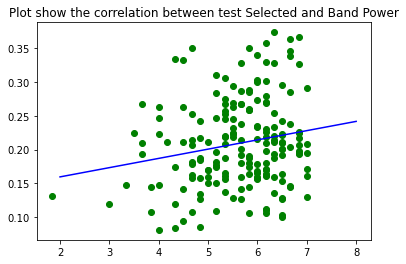

(0.19045621619812325, 0.009411317921868806)


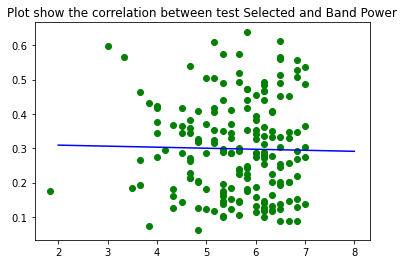

(-0.019928507078709114, 0.7877399541052422)


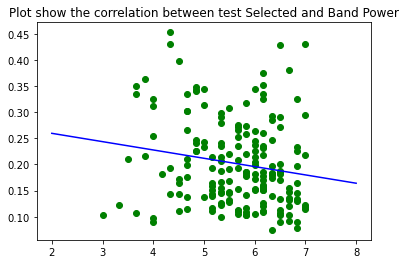

(-0.16750070739806544, 0.024207089724403438)


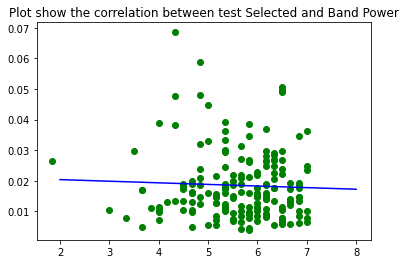

(-0.04221604410352642, 0.5725666203672392)
EC, Well Being, Brain Reagion:  Posterior_midline


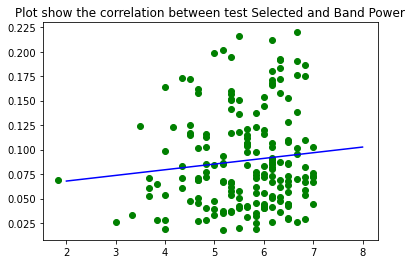

(0.10767284472543849, 0.1457176996255367)


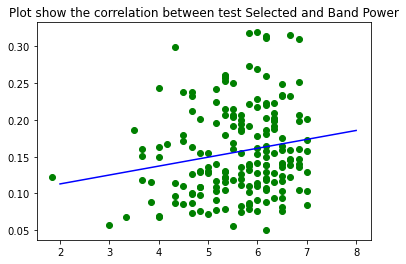

(0.18142892371735347, 0.013973601908884692)


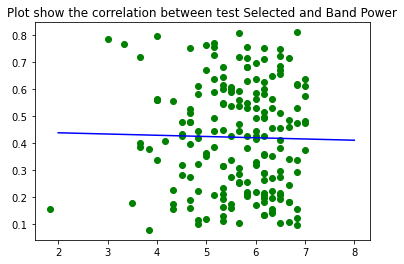

(-0.021069157446294322, 0.7747124522885571)


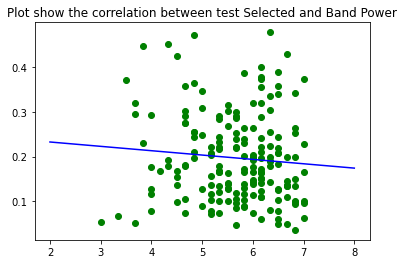

(-0.08642058149143697, 0.2447309605769751)


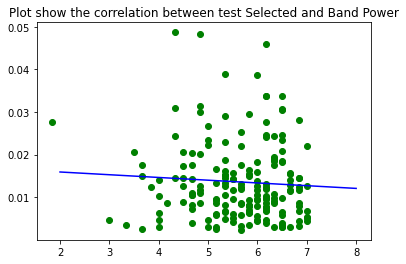

(-0.06384951502109183, 0.3905069634021879)
EC, Well Being, Brain Reagion:  Right_central


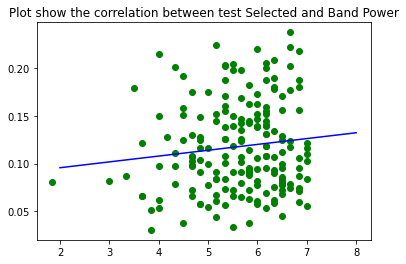

(0.11884128045541878, 0.10714152389648936)


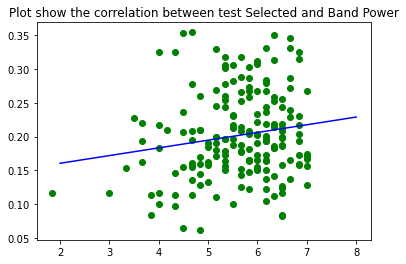

(0.16157889595721905, 0.028434033130198176)


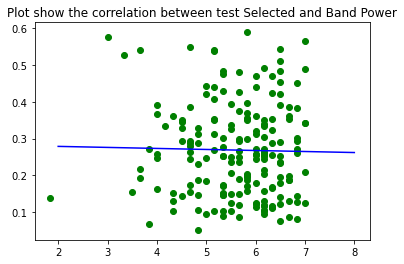

(-0.02001462257502047, 0.786844643596433)


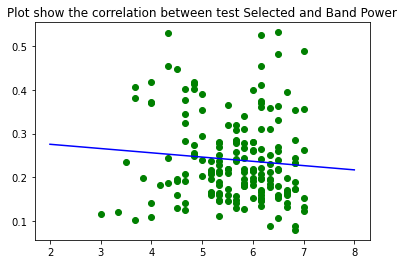

(-0.08779825268127346, 0.23987781525952556)


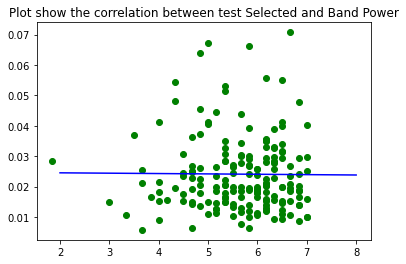

(-0.008789252833656249, 0.9065190440360092)


In [13]:
save_corr_well_EC = []
for r in range(0,12):
    print('EC, Well Being, Brain Reagion: ',lis_noms[r])
    cor = calcul(names, listEC_Names[r], TeiQueSF_wellBeing, dataEC[r], 2, 8)
    save_corr_well_EC.append(cor)

In [14]:
#EO - emotionality
EOemotionality = []
for i in range(0,len(lis_noms)):
    lis_mitx = []
    
    lol=[]
    for e in range(0, len(labels)):
        lis_labels = []
        lis_labels.append(lis_noms[i])
        lis_labels.append(labels[e])
        lis_labels.append(save_corr_emotio_EO[i][e][0])
        lis_labels.append(save_corr_emotio_EO[i][e][1])
        lis_labels.append(rac_emotio_EO[i][e][1])
        #lis_labels.append(save_corr2[i][e][1])

        lol.append(lis_labels)
        EOemotionality.append(lis_labels)

In [15]:
#EO - well
EOwell = []
for i in range(0,len(lis_noms)):
    lis_mitx = []
    
    lol=[]
    for e in range(0, len(labels)):
        lis_labels = []
        lis_labels.append(lis_noms[i])
        lis_labels.append(labels[e])
        lis_labels.append(save_corr_well_EO[i][e][0])
        lis_labels.append(save_corr_well_EO[i][e][1])
        lis_labels.append(rac_well_EO[i][e][1])
        #lis_labels.append(save_corr_well2[i][e][1])

        lol.append(lis_labels)
        EOwell.append(lis_labels)



In [16]:
#EC - emotio
ECemotio = []
for i in range(0,len(lis_noms)):
    lis_mitx = []
    
    lol=[]
    for e in range(0, len(labels)):
        lis_labels = []
        lis_labels.append(lis_noms[i])
        lis_labels.append(labels[e])
        lis_labels.append(save_corr_emotio_EC[i][e][0])
        lis_labels.append(save_corr_emotio_EC[i][e][1])
        lis_labels.append(rac_emotio_EC[i][e][1])
        #lis_labels.append(save_corrEC2[i][e][1])

        lol.append(lis_labels)
        ECemotio.append(lis_labels)

In [17]:
#EC - well
ECwell = []
for i in range(0,len(lis_noms)):
    lis_mitx = []
    
    lol=[]
    for e in range(0, len(labels)):
        lis_labels = []
        lis_labels.append(lis_noms[i])
        lis_labels.append(labels[e])
        lis_labels.append(save_corr_well_EC[i][e][0])
        lis_labels.append(save_corr_well_EC[i][e][1])
        lis_labels.append(rac_well_EC[i][e][1])
        #lis_labels.append(save_corrEC_well2[i][e][1])

        lol.append(lis_labels)
        ECwell.append(lis_labels)

In [18]:
import pandas
df = pandas.DataFrame(data=EOemotionality)
df.to_csv("EOemotio.csv", sep=',',index=False)

In [19]:
df = pandas.DataFrame(data=EOwell)
df.to_csv("EOwell.csv", sep=',',index=False)

In [20]:
df = pandas.DataFrame(data=ECemotio)
df.to_csv("ECemotio.csv", sep=',',index=False)

In [21]:
df = pandas.DataFrame(data=ECwell)
df.to_csv("ECwell.csv", sep=',',index=False)

In [22]:
from sklearn.preprocessing import StandardScaler
from pandas import DataFrame
labels = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gama Lower']
features =  [['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama'], ['Anterior_midline_Delta', 'Anterior_midline_Theta', 'Anterior_midline_Alpha', 'Anterior_midline_Beta', 'Anterior_midline_Gama']]
df = DataFrame (dataEC)


In [23]:
len(dataEC[0][2])

182

In [24]:
df

,0,1,2,3,4
0,"[0.11593215715384694, 0.12153745188124469, 0.1...","[0.12918560914503155, 0.31403097050883505, 0.2...","[0.11048052184631056, 0.2248768416123358, 0.16...","[0.4490458864026436, 0.07952750432563525, 0.22...","[0.06170723224936936, 0.009822012214276879, 0...."
1,"[0.11832692636935804, 0.1257749827113987, 0.11...","[0.13361659712901713, 0.2774800390631631, 0.23...","[0.13359803015029006, 0.24906728006031575, 0.2...","[0.3964925237577096, 0.09474048617447425, 0.18...","[0.0623661149122757, 0.008173227169010304, 0.0..."
2,"[0.11545076275825636, 0.1275764304397786, 0.12...","[0.14013866887479653, 0.2535375202212893, 0.24...","[0.14360747687666325, 0.2454752768513624, 0.19...","[0.41591319196728654, 0.1056025927680887, 0.21...","[0.05810149606968122, 0.008111649591600864, 0...."
3,"[0.09889832092906829, 0.11825285037885257, 0.0...","[0.11829754818757282, 0.3491756717772207, 0.31...","[0.14389185334316804, 0.28169213599300125, 0.2...","[0.38620275414682353, 0.12734426487808262, 0.1...","[0.005661513890403616, 0.01323330277267948, 0...."
4,"[0.07658013680540511, 0.09446600825238512, 0.0...","[0.10359696200442481, 0.3611948960149531, 0.28...","[0.15896244637332518, 0.29701107559556134, 0.2...","[0.4788440146288603, 0.13572956517723067, 0.19...","[0.009577122510287955, 0.016166652030641042, 0..."
5,"[0.05845028949701127, 0.08421702230059622, 0.0...","[0.085894185045444, 0.29781021540571356, 0.273...","[0.25232675111660435, 0.42729219320174966, 0.2...","[0.1000736139360486, 0.2285122600465536, 0.128...","[0.025180396714496563, 0.004707414771298108, 0..."
6,"[0.06640328255251904, 0.065669380470499, 0.051...","[0.09825386181124084, 0.2499666654187854, 0.25...","[0.31690172801643485, 0.5099805066134847, 0.33...","[0.43161061767736125, 0.10149240599757728, 0.2...","[0.01786480915459817, 0.00591804953666616, 0.0..."
7,"[0.08022044875688522, 0.07072329278159642, 0.0...","[0.11487038843785018, 0.25367427289128797, 0.2...","[0.31856373352476425, 0.5060449352256804, 0.36...","[0.37414802136446446, 0.0958702905044878, 0.24...","[0.021902184957792756, 0.004554349870667536, 0..."
8,"[0.0758954246625209, 0.0767634433011836, 0.057...","[0.11054244367084638, 0.319005325347628, 0.250...","[0.26136655503209694, 0.40110296701416454, 0.3...","[0.4521959583457157, 0.1001712692032617, 0.252...","[0.020740398636548866, 0.004161986342753929, 0..."
9,"[0.09437938292774825, 0.12432268232763018, 0.0...","[0.1284303800151179, 0.35003027292409894, 0.29...","[0.19239904574609917, 0.26147883319262993, 0.3...","[0.42867258821492793, 0.13735557114472408, 0.1...","[0.04951858889491658, 0.005025057024257246, 0...."
